# Chronic Lymphotic Leukemia dataset

Pacienti s chronickou leukémiou chodia na pravidelné vyšetrenie, bežne raz za mesiac. Choroba sa lieči ale sa nevylieči. Keď je stav zlepšený, tak môžu chodiť v intervale 3 alebo 6 mesiacov. Laboratórne vyšetrenie sa robí odberom, potom testy v laboratoriách, hodnoty sa sumarizujú a posielajú naspäť lekárom. Každé takéto vyšetrenie má rozsiahle výsledky, ktoré sa hodnotia dlho. Nemocnica vedie aj centrálne záznamy o pacientoch (osobné údaje), kontakty s poisťovňou aj ďalšie potrebné údaje.

V záznamoch laboratórnych vyšetrení je závislá premenná (**indikator**) indikujúca stavu choroby pacienta. Ide o indikáciu či patient potrebuje ďalšie laboratórne vyšetrenie v preddefinovanom intervale alebo ten interval sa dá predĺžiť na základe výsledkov laboratorných testov aj osobných údajov pacienta.

Pokiaľ má indikátor nenulovú hodnotu, pacientov stav nie je zlepšený a je nutné ďalšie laboratórne vyšetrenie.

V dátach sú údaje 3060 ľudí. **SSN - social security number** je ich unique ID.



| atribút     | poznámka                                           |
|-------------|----------------------------------------------------|
| hemoglobin  | farbivo červených krviniek                         |
| hematocrit  | percentuálne zastúpenie červených krviniek v krvi  |
| leukocytes  | biele krvinky                                      |
| erytrocytes | červené krvinky                                    |
| trombocytes | krvné doštičky                                     |
| alt         | alanine aminotransferase enzým                     |
| alp         | alkaline phosphatase enzým                         |
| ast         | aspartate aminotransferase enzým                   |
| er-cv       |                                                    |
| etytr       |                                                    |
| hbver       |                                                    |



In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import scipy.stats as stats
from datetime import date
import statsmodels.api as sm
import pylab as py

## Základný opis dát spolu s ich charakteristikami
### Tabuľka *labor.csv*

In [2]:
filename = "data/labor.csv"
labor = pd.read_csv(filename, sep='\t', index_col=0, dtype={
                    'name': str
                    #'indicator': bool
                 })

labor.head(2)

,name,hematokrit,smoker,leukocyty,relationship,ssn,alt,weight,erytrocyty,alp,ast,er-cv,etytr,hemoglobin,trombocyty,indicator,hbver
0,Courtney Sparks,5.10789,no,3.67594,married,211-15-5030,1.36076,65.50748,7.92270,80.65839,40.27331,46.67907,6.93084,7.07385,2.43339,0.0,6.73439
1,David Cook,6.06717,no,6.61722,divoced,134-25-6459,1.10335,80.56053,7.13748,95.49950,51.14865,21.09764,6.17378,6.30636,3.16922,0.0,6.69188


In [3]:
labor.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10039 entries, 0 to 10038
Data columns (total 17 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   name          10039 non-null  object 
 1   hematokrit    10008 non-null  float64
 2   smoker        10039 non-null  object 
 3   leukocyty     10009 non-null  float64
 4   relationship  10039 non-null  object 
 5   ssn           10039 non-null  object 
 6   alt           10009 non-null  float64
 7   weight        10039 non-null  float64
 8   erytrocyty    10009 non-null  float64
 9   alp           10008 non-null  float64
 10  ast           10009 non-null  float64
 11  er-cv         10009 non-null  float64
 12  etytr         10008 non-null  float64
 13  hemoglobin    10009 non-null  float64
 14  trombocyty    10009 non-null  float64
 15  indicator     10039 non-null  float64
 16  hbver         10009 non-null  float64
dtypes: float64(13), object(4)
memory usage: 1.4+ MB


#### Null hodnoty

In [4]:
labor.isnull().sum()

name             0
hematokrit      31
smoker           0
leukocyty       30
relationship     0
ssn              0
alt             30
weight           0
erytrocyty      30
alp             31
ast             30
er-cv           30
etytr           31
hemoglobin      30
trombocyty      30
indicator        0
hbver           30
dtype: int64

In [5]:
labor.shape[0] - labor.dropna().shape[0]

326

NA hodnoty sú v 326 riadkoch.

In [6]:
labor[labor.isnull().any(axis=1)].head(2)

,name,hematokrit,smoker,leukocyty,relationship,ssn,alt,weight,erytrocyty,alp,ast,er-cv,etytr,hemoglobin,trombocyty,indicator,hbver
2,Diane Dunn,NaN,no,8.84155,married,410-38-6674,2.32670,165.53795,8.77005,88.36972,56.40210,28.48174,7.23321,6.44218,6.13313,0.0,6.3377
23,Holly Rivas,5.64213,no,4.99301,single,294-89-0623,2.06143,69.21325,8.63682,37.10210,49.40716,63.02882,6.49911,4.28108,6.30883,0.0,NaN


#### Atribúty

In [7]:
labor.describe()

,hematokrit,leukocyty,alt,weight,erytrocyty,alp,ast,er-cv,etytr,hemoglobin,trombocyty,indicator,hbver
count,10008.000000,10009.000000,10009.000000,10039.000000,10009.000000,10008.000000,10009.000000,10009.000000,10008.000000,10009.000000,10009.00000,10039.000000,10009.000000
mean,6.453032,6.450274,1.306090,69.805192,6.898802,71.949719,52.343359,49.060376,6.476717,6.464414,6.82846,0.642295,6.475601
std,1.665991,1.700428,2.080683,35.581044,1.605785,18.109229,11.880597,13.084279,0.994156,1.006072,1.73433,0.479349,1.004527
min,0.683890,0.979140,0.000000,-59.892790,1.811270,0.000000,0.000000,0.000000,2.678710,3.054200,0.00000,0.000000,2.738210
25%,5.197180,5.177990,0.521560,46.183730,5.748830,63.818647,44.490180,40.393810,5.802672,5.786020,5.66519,0.000000,5.806840
50%,6.227605,6.352150,0.773820,70.018130,7.036180,78.203065,52.376590,48.923340,6.480035,6.476210,7.00289,1.000000,6.478430
75%,7.669982,7.693890,1.344220,93.175640,8.052080,84.986902,60.275100,57.766910,7.147997,7.140870,8.07872,1.000000,7.147590
max,13.633550,12.694630,100.000000,188.436090,12.733320,100.000000,100.000000,100.000000,11.426920,10.112330,12.59522,1.000000,10.361820


In [8]:
labor.groupby('smoker').size()

smoker
N       472
Y      1962
no     5580
yes    2025
dtype: int64

- dataset má 10039 riadkov a 17 stĺpcov
- číselné hodnoty majú dátový typ *float64*, ostatné atribúty majú dátový typ *object*
- *alt, alp, ast, er-cv, hematocrit* sú pravdepodobne percentuálne hodnoty

### Tabuľka *profiles.csv*

In [9]:
filename = "data/profiles.csv"
profiles = pd.read_csv(filename, sep='\t', index_col=0, parse_dates=['birthdate'])
profiles.head(2)

,blood_group,company,job,ssn,sex,birthdate,race,name,address
0,A-,Yu Group,"Engineer, energy",383-82-1198,M,1946-08-10,White,John Beard,"2896 Juan Manor\nNorth Douglasmouth, LA 50163"
1,O-,"Chase, Brown and Price","Designer, furniture",828-02-1024,M,1933-01-31,Black,Dustin Oneal,"225 Moore Glen Suite 019\nAmandastad, WA 64166"


In [10]:
profiles.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3060 entries, 0 to 3059
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   blood_group  3060 non-null   object        
 1   company      3060 non-null   object        
 2   job          3060 non-null   object        
 3   ssn          3060 non-null   object        
 4   sex          3060 non-null   object        
 5   birthdate    3060 non-null   datetime64[ns]
 6   race         3060 non-null   object        
 7   name         3060 non-null   object        
 8   address      3060 non-null   object        
dtypes: datetime64[ns](1), object(8)
memory usage: 239.1+ KB


Tabuľka nikde neobsahuje null hodnoty.

In [11]:
cols = set(profiles.columns) - {'address', 'ssn', 'birthdate'}
profiles_desc = profiles[list(cols)]
profiles_desc.describe()

,name,race,sex,company,job,blood_group
count,3060,3060,3060,3060,3060,3060
unique,2986,8,2,2864,634,8
top,Robert Johnson,White,F,Jones PLC,Academic librarian,B-
freq,4,1516,1535,6,13,400


In [12]:
profiles.groupby('sex').size()

sex
F    1535
M    1525
dtype: int64

In [13]:
profiles.groupby('race').size()

race
Asian        316
Black        768
Hawaiian     142
Indian       159
White       1516
black         86
blsck         43
white         30
dtype: int64

- dataset má 3060 riadkov a 9 stĺpcov
- *birthdate* bol pri načítavaní preparsovaný na dátový typ *datetime* s formátom YYYY-MM-DD, ostatné atribúty majú dátový typ *object*

____

## Identifikácia problémov v dátach a ich úprava

**Tabuľka *labor***
- zmena hodnoty *smoker* z 'N' na 'no' a z 'Y' na 'yes'
- zmena atribútu *relationship* s hodnotou 'nop' na 'single'
- premenovanie názvov stĺpcov


- odstraňovanie duplikátov
- odstaňovanie null hodnôt
- odstraňovanie outlierov pri atribúte *alt* (jedna veľmi odchýlená hodnota)


- *weight* obsahuje nereálne hodnoty - záporné a desatinné hodnoty - upravené na absolútnu hodnotu

In [14]:
labor['smoker'] = np.where(labor['smoker'] == 'N', 'no', labor['smoker'])
labor['smoker'] = np.where(labor['smoker'] == 'Y', 'yes', labor['smoker'])

In [15]:
labor['relationship'] = np.where(labor['relationship'] == 'nop', 'single', labor['relationship'])

In [16]:
labor.rename(columns = {'hematokrit':'hematocrit', 'leukocyty':'leukocytes', 'erytrocyty':'erytrocytes', 'trombocyty':'trombocytes'}, inplace = True)

In [17]:
labor.duplicated().sum()

99

In [18]:
labor.loc[labor.duplicated()].head(2)

,name,hematocrit,smoker,leukocytes,relationship,ssn,alt,weight,erytrocytes,alp,ast,er-cv,etytr,hemoglobin,trombocytes,indicator,hbver
511,Maria Soto,5.93419,yes,5.78903,single,859-22-4510,0.57107,90.84491,7.01742,72.18599,61.48739,26.17026,6.70537,5.47194,6.09018,0.0,7.77870
848,Kevin Rhodes,7.41350,no,6.35816,single,465-82-7845,0.58018,19.60382,6.82190,91.82476,44.92321,44.38709,6.60090,6.54147,5.26880,0.0,4.92355


In [19]:
labor.loc[labor['name'] == 'Alexis Hernandez'].sort_values(by=['hematocrit'])

,name,hematocrit,smoker,leukocytes,relationship,ssn,alt,weight,erytrocytes,alp,ast,er-cv,etytr,hemoglobin,trombocytes,indicator,hbver
190,Alexis Hernandez,4.87963,yes,5.47451,separated,891-91-0854,0.77645,81.44784,6.93854,73.75405,50.72494,64.27982,6.35253,7.19353,6.40244,0.0,5.34128
2510,Alexis Hernandez,6.78306,no,8.62184,widowed,891-91-0854,0.43857,78.32595,3.07673,64.69622,53.87643,54.75380,5.40588,4.96864,9.29252,0.0,6.09341
7158,Alexis Hernandez,6.78306,no,8.62184,widowed,891-91-0854,0.43857,78.32595,3.07673,64.69622,53.87643,54.75380,5.40588,4.96864,9.29252,0.0,6.09341
6549,Alexis Hernandez,7.46376,no,5.03188,married,891-91-0854,0.53384,114.50787,5.62644,82.72743,66.96557,26.71102,7.93353,6.11791,7.62670,1.0,6.43893
9144,Alexis Hernandez,7.46376,no,5.03188,married,891-91-0854,0.53384,114.50787,5.62644,82.72743,66.96557,26.71102,7.93353,6.11791,7.62670,1.0,6.43893
9686,Alexis Hernandez,8.18694,yes,8.52238,single,891-91-0854,2.27023,89.62500,8.74601,77.22858,61.48254,57.43957,7.55003,7.02210,5.34141,0.0,6.53915


Zobrazenie konkrétneho človeka s duplicitnými záznamami.

In [20]:
labor.drop_duplicates(inplace=True)

In [21]:
labor = labor.dropna()

In [22]:
labor.shape

(9617, 17)

<AxesSubplot:>

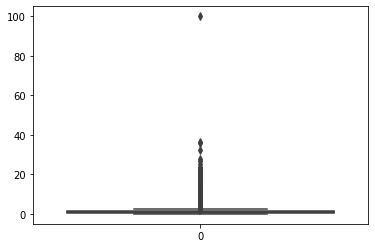

In [23]:
sns.boxplot(data=labor['alt'])

In [24]:
labor.drop(labor.loc[labor['alt'] == 100].index, inplace=True)
#labor.loc[labor['alt'] > 40]

In [25]:
labor.shape

(9616, 17)

<AxesSubplot:>

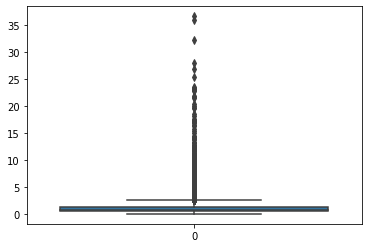

In [26]:
sns.boxplot(data=labor['alt'])

In [27]:
labor['weight'] = labor['weight'].abs()

**Tabuľka *profiles***
- zmena *race* s hodnotou 'black' alebo 'blsck' na 'Black' a 'white' na 'White'
- *birthdate* má veľa rôznych formátov - parsovanie na správny formát prebehlo pri načítavaní zo súboru
- pridaný nový stĺpec *age* s vypočítaným vekom osoby

In [28]:
profiles['race'] = np.where((profiles['race'] == 'black') | (profiles['race'] == 'blsck'), 'Black', profiles['race'])
profiles['race'] = np.where(profiles['race'] == 'white', 'White', profiles['race'])

In [29]:
today = date.today()
profiles['age'] = profiles.apply(lambda row: today.year - row.birthdate.year - 
                                 ((today.month, today.day) < (row.birthdate.month, row.birthdate.day)), axis = 1)

In [30]:
profiles.age.describe()

count    3060.000000
mean       58.831046
std        33.342584
min         0.000000
25%        31.000000
50%        59.000000
75%        88.000000
max       116.000000
Name: age, dtype: float64

____

## Spojenie tabuliek

Na uľahčenie práce s dátami vytvoríme jednu tabuľku - *data*, ktorá je spojená podľa unikátneho identifikátora *ssn*.

Sú v nej zahrnuté iba relevantné atribúty, takže neobsahuje *birthdate, company, job, name* a *address*.

In [31]:
data = labor.merge(profiles, how='left', on='ssn')

include = set(data.columns) - {'birthdate', 'company', 'job', 'name_x', 'name_y', 'address'}
data = data[list(include)]

In [32]:
data.head()

,alt,trombocytes,leukocytes,relationship,er-cv,erytrocytes,ast,sex,etytr,hematocrit,weight,hemoglobin,indicator,race,smoker,ssn,alp,age,blood_group,hbver
0,1.36076,2.43339,3.67594,married,46.67907,7.92270,40.27331,F,6.93084,5.10789,65.50748,7.07385,0.0,Black,no,211-15-5030,80.65839,106,AB+,6.73439
1,1.10335,3.16922,6.61722,divoced,21.09764,7.13748,51.14865,M,6.17378,6.06717,80.56053,6.30636,0.0,Black,no,134-25-6459,95.49950,62,A-,6.69188
2,3.08378,5.54453,8.76540,married,67.05110,9.11128,57.61393,F,7.25101,8.52161,56.12232,7.74219,0.0,Black,yes,327-02-6401,57.21363,115,B+,6.08754
3,5.08135,5.34519,6.61320,divoced,53.04260,9.68805,75.41991,M,6.18335,4.35962,93.52107,5.69975,0.0,White,no,469-50-8029,82.12788,113,A-,6.34100
4,0.89996,7.49621,6.52586,divoced,60.41555,7.78640,44.08776,F,5.33112,5.32524,57.01768,6.68497,1.0,Asian,yes,755-50-6094,80.50126,94,O-,6.88636


In [33]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9616 entries, 0 to 9615
Data columns (total 20 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   alt           9616 non-null   float64
 1   trombocytes   9616 non-null   float64
 2   leukocytes    9616 non-null   float64
 3   relationship  9616 non-null   object 
 4   er-cv         9616 non-null   float64
 5   erytrocytes   9616 non-null   float64
 6   ast           9616 non-null   float64
 7   sex           9616 non-null   object 
 8   etytr         9616 non-null   float64
 9   hematocrit    9616 non-null   float64
 10  weight        9616 non-null   float64
 11  hemoglobin    9616 non-null   float64
 12  indicator     9616 non-null   float64
 13  race          9616 non-null   object 
 14  smoker        9616 non-null   object 
 15  ssn           9616 non-null   object 
 16  alp           9616 non-null   float64
 17  age           9616 non-null   int64  
 18  blood_group   9616 non-null 

______

## Charakteristiky a vizualizácia dát

1.0    6183
0.0    3433
Name: indicator, dtype: int64

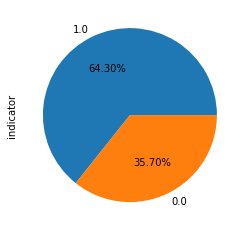

In [34]:
data.indicator.value_counts().plot(kind='pie', autopct='%.2f%%')
data.indicator.value_counts()

<AxesSubplot:ylabel='smoker'>

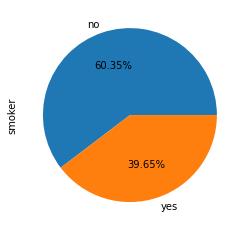

In [35]:
data.smoker.value_counts().plot(kind='pie', autopct='%.2f%%')

<AxesSubplot:ylabel='sex'>

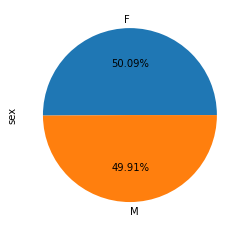

In [36]:
data.sex.value_counts().plot(kind='pie', autopct='%.2f%%')

White       4880
Black       2796
Asian        991
Indian       506
Hawaiian     443
Name: race, dtype: int64

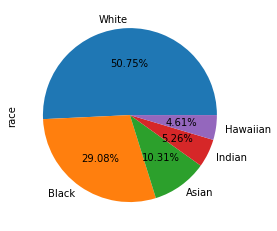

In [37]:
data.race.value_counts().plot(kind='pie', autopct='%.2f%%')
data.race.value_counts()

<AxesSubplot:ylabel='relationship'>

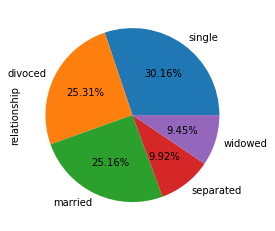

In [38]:
data.relationship.value_counts().plot(kind='pie', autopct='%.2f%%')

<AxesSubplot:xlabel='blood_group', ylabel='Count'>

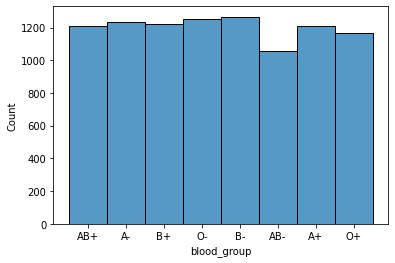

In [39]:
sns.histplot(data['blood_group'])

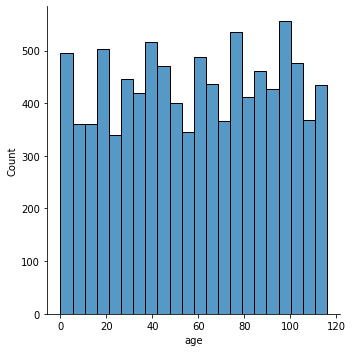

In [40]:
sns.displot(data['age'])

Text(0.5, 1.0, 'Highly positively skewed: Skewness 7.08666')

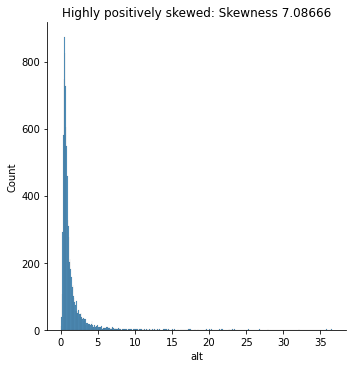

In [41]:
sns.displot(data['alt'])
plt.title("Highly positively skewed: ""Skewness %.5f" % (stats.skew(data['alt']), ))

In [42]:
stats.kurtosis(data['alt'], fisher=False)

83.6358345739308

Normálne rozdelenie má hodnotu kurtosis 3. Hodnoty v stĺpci alt sú sústredené okolo jedného bodu na ľavom okraji.

Text(0.5, 1.0, 'Fairly symmetrical, no skewness: Skewness 0.00102')

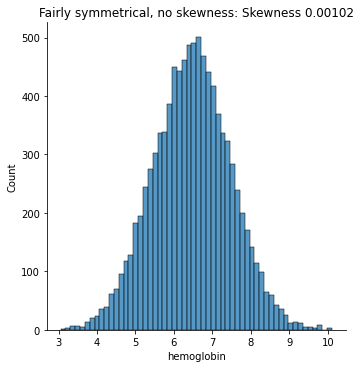

In [43]:
sns.displot(data['hemoglobin'])
plt.title("Fairly symmetrical, no skewness: ""Skewness %.5f" % (stats.skew(data['hemoglobin']), ))

In [44]:
stats.kurtosis(data['hemoglobin'], fisher=False)

3.0021493542598985

Normálne rozdelenie má hodnotu kurtosis 3. Hodnoty takmer zodpovedajú normálnemu rozdeleniu.

array([[<AxesSubplot:title={'center':'hematocrit'}>,
        <AxesSubplot:title={'center':'leukocytes'}>,
        <AxesSubplot:title={'center':'alt'}>,
        <AxesSubplot:title={'center':'weight'}>],
       [<AxesSubplot:title={'center':'erytrocytes'}>,
        <AxesSubplot:title={'center':'alp'}>,
        <AxesSubplot:title={'center':'ast'}>,
        <AxesSubplot:title={'center':'er-cv'}>],
       [<AxesSubplot:title={'center':'etytr'}>,
        <AxesSubplot:title={'center':'hemoglobin'}>,
        <AxesSubplot:title={'center':'trombocytes'}>,
        <AxesSubplot:title={'center':'indicator'}>],
       [<AxesSubplot:title={'center':'hbver'}>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

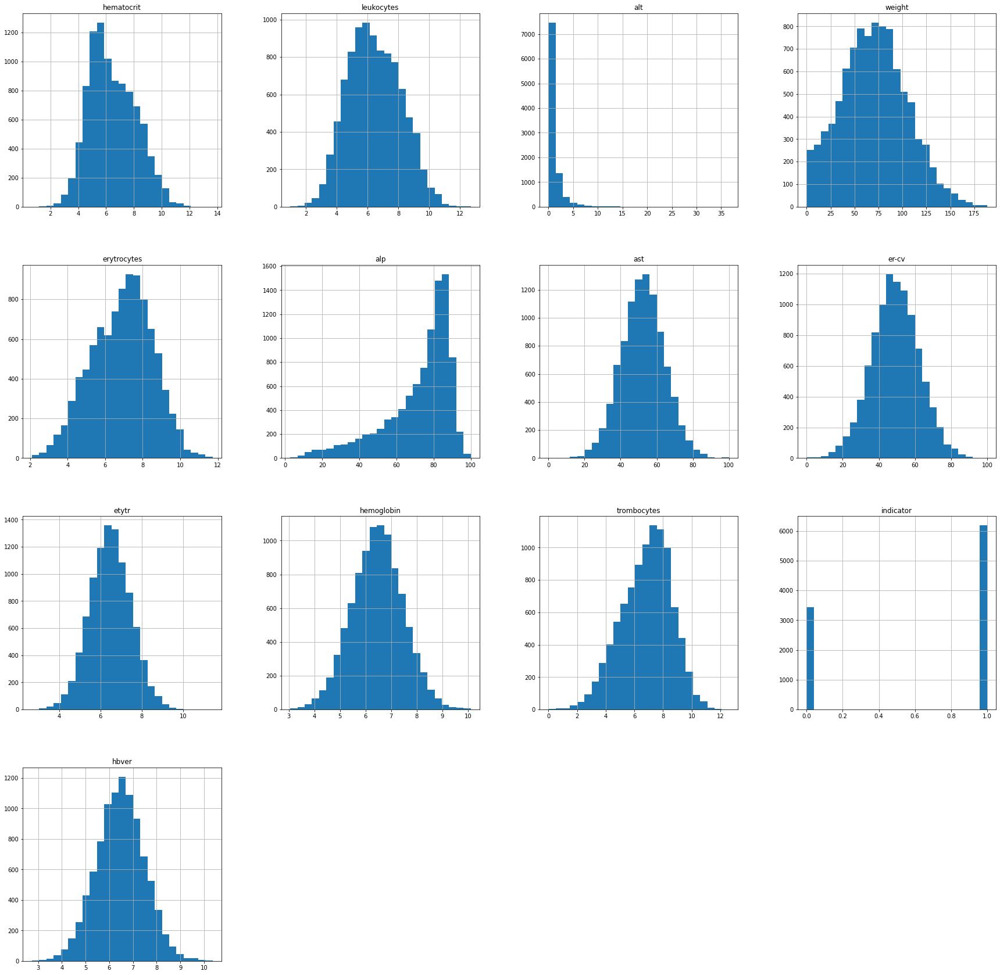

In [45]:
labor.hist(figsize=(30,30), bins=25)

<AxesSubplot:>

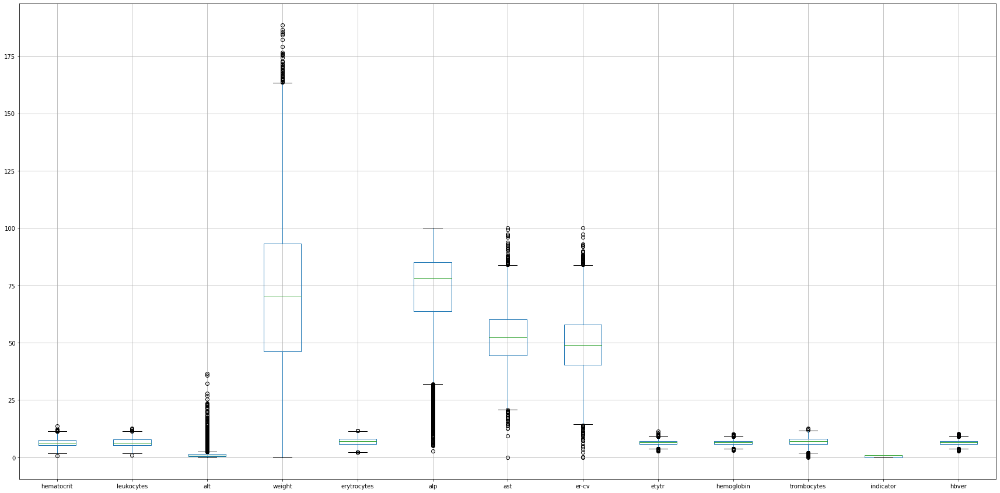

In [46]:
labor.boxplot(figsize=(30,15))

<AxesSubplot:title={'center':'Mean'}>

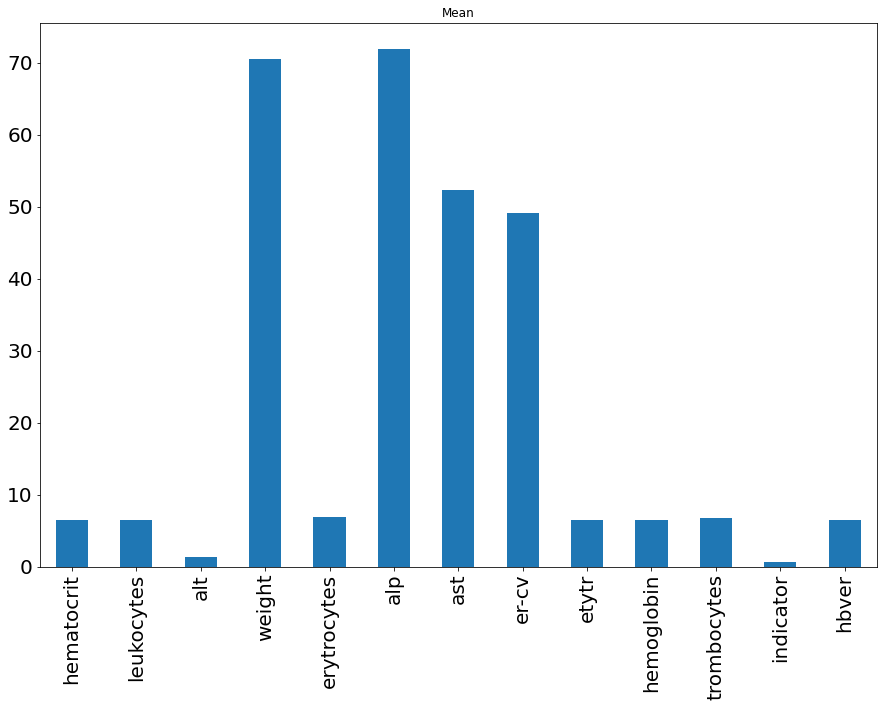

In [47]:
labor.mean(numeric_only=True).plot(kind='bar', figsize=(15,10), fontsize=20, title="Mean")

<AxesSubplot:title={'center':'Standard deviation'}>

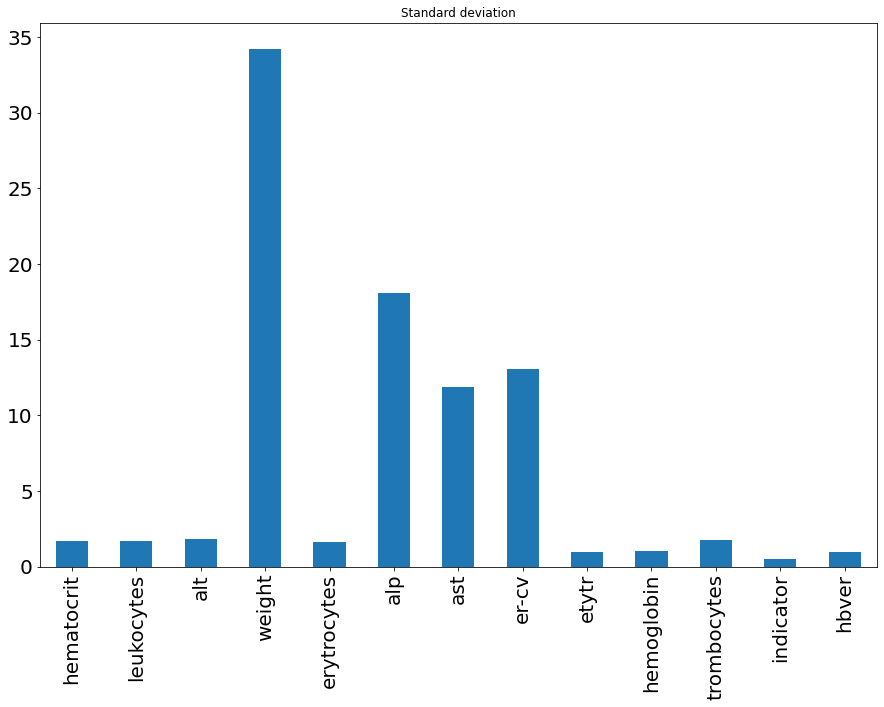

In [48]:
labor.std(numeric_only=True).plot(kind='bar', figsize=(15,10), fontsize=20, title="Standard deviation")

<AxesSubplot:title={'center':'Skewness'}>

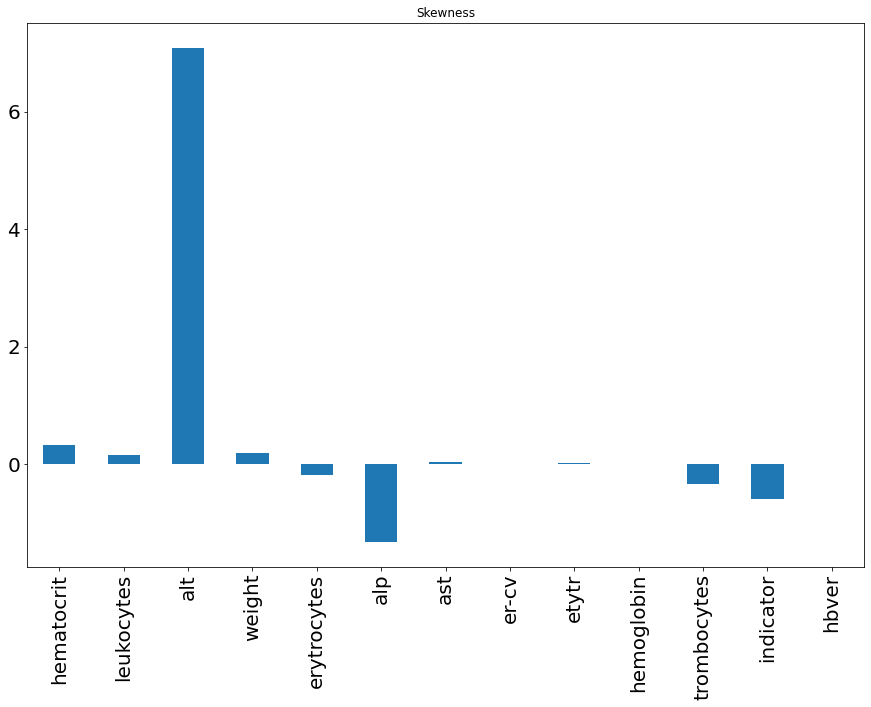

In [49]:
labor.skew(numeric_only=True).plot(kind='bar', figsize=(15,10), fontsize=20, title="Skewness")

<AxesSubplot:title={'center':'Kurtosis (without alt)'}>

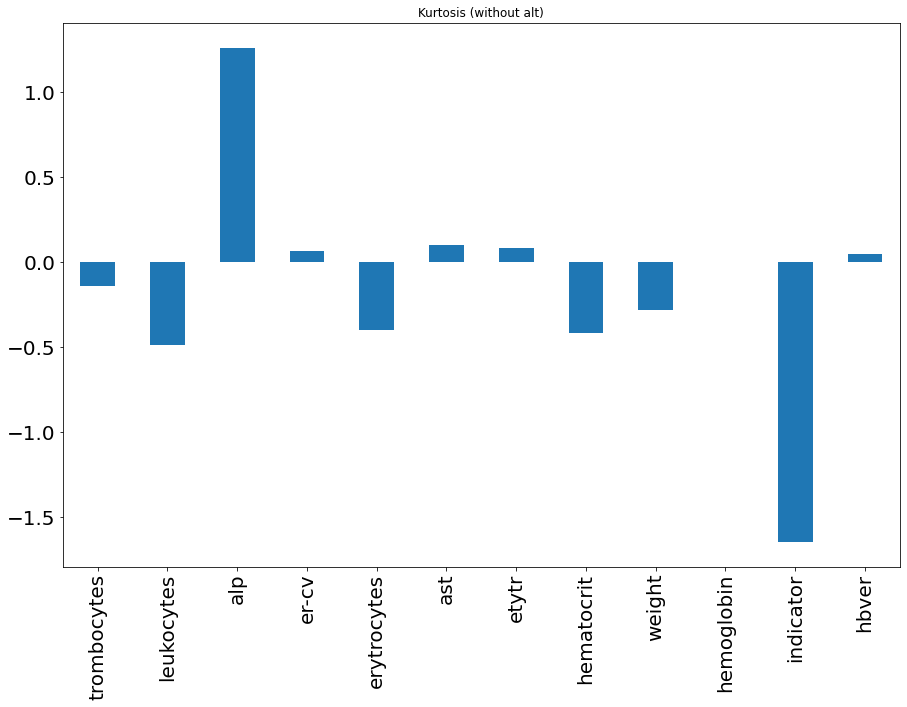

In [50]:
include = set(labor.columns) - {'alt'}
bezalt = labor[list(include)]
bezalt.kurtosis(numeric_only=True).plot(kind='bar', figsize=(15,10), fontsize=20, title="Kurtosis (without alt)")

_____

## Párová analýza dát

### Korelácia dát:

<AxesSubplot:>

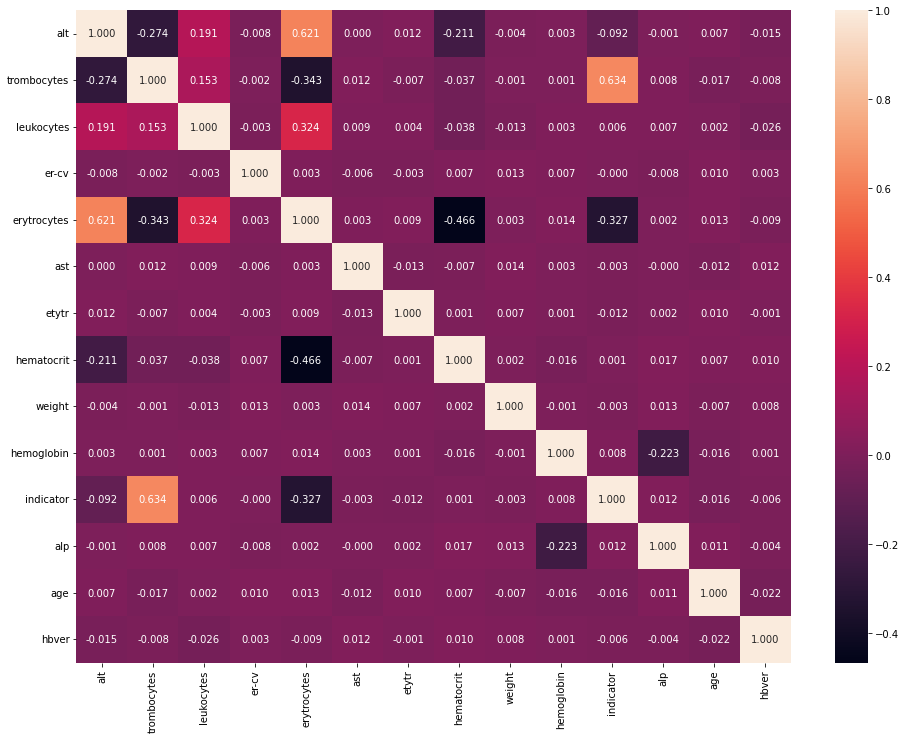

In [51]:
fig, ax = plt.subplots(figsize=(16,12))
sns.heatmap(data.corr(), ax=ax, annot=True, fmt=".3f")

Najznačnejšia kladná korelácia je medzi *trombocytes* a *indicator* a záporná medzi *hematocrit* a *erytrocytes*.

### Korelácia dát podľa zmeny indikátora:

<AxesSubplot:>

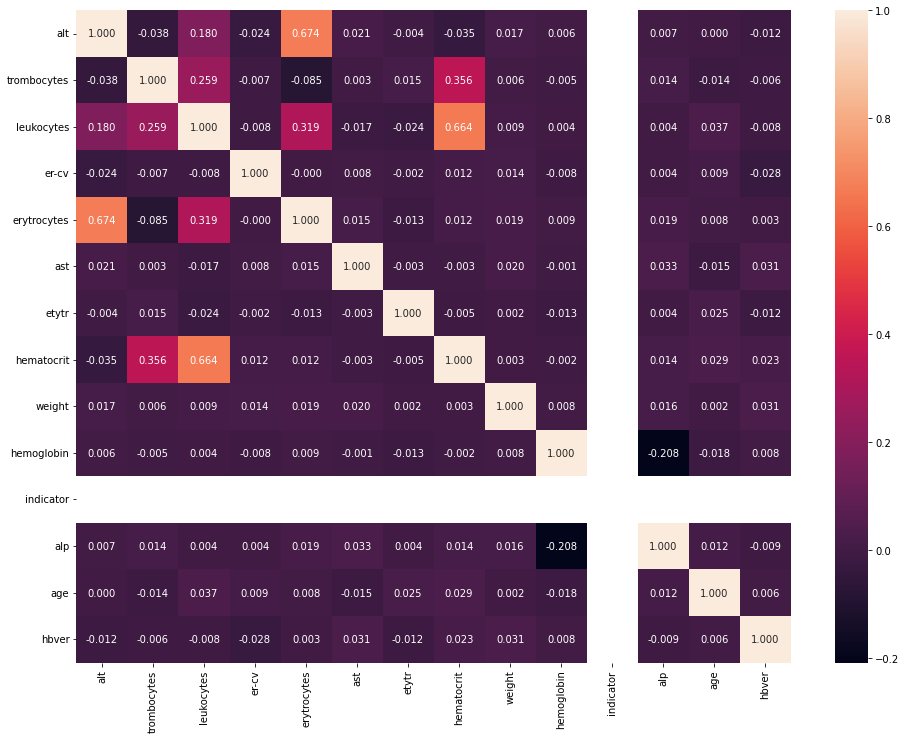

In [52]:
fig, ax = plt.subplots(figsize=(16,12))
sns.heatmap(data[data.indicator == 0].corr(), ax=ax, annot=True, fmt=".3f")

Ak je indikátor rovný 0, nastáva značná kladná korelácia medzi atribútami *leukocytes* a *hematocrit*, *erytrocytes* a *alt* a záporná medzi *alp* a *hemoglobin*.

<AxesSubplot:>

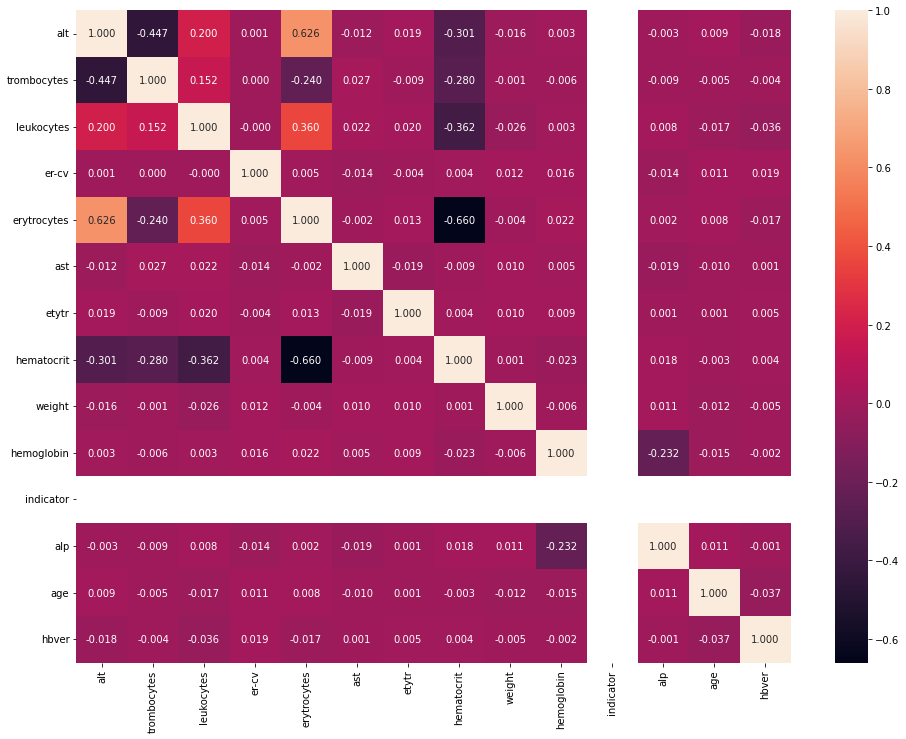

In [53]:
fig, ax = plt.subplots(figsize=(16,12))
sns.heatmap(data[data.indicator == 1].corr(), ax=ax, annot=True, fmt=".3f")

Ak je indikátor rovný 1, nastáva značná kladná korelácia medzi atribútami *erytrocytes* a *alt* a záporná medzi *erytrocytes* a *hematocrit*.

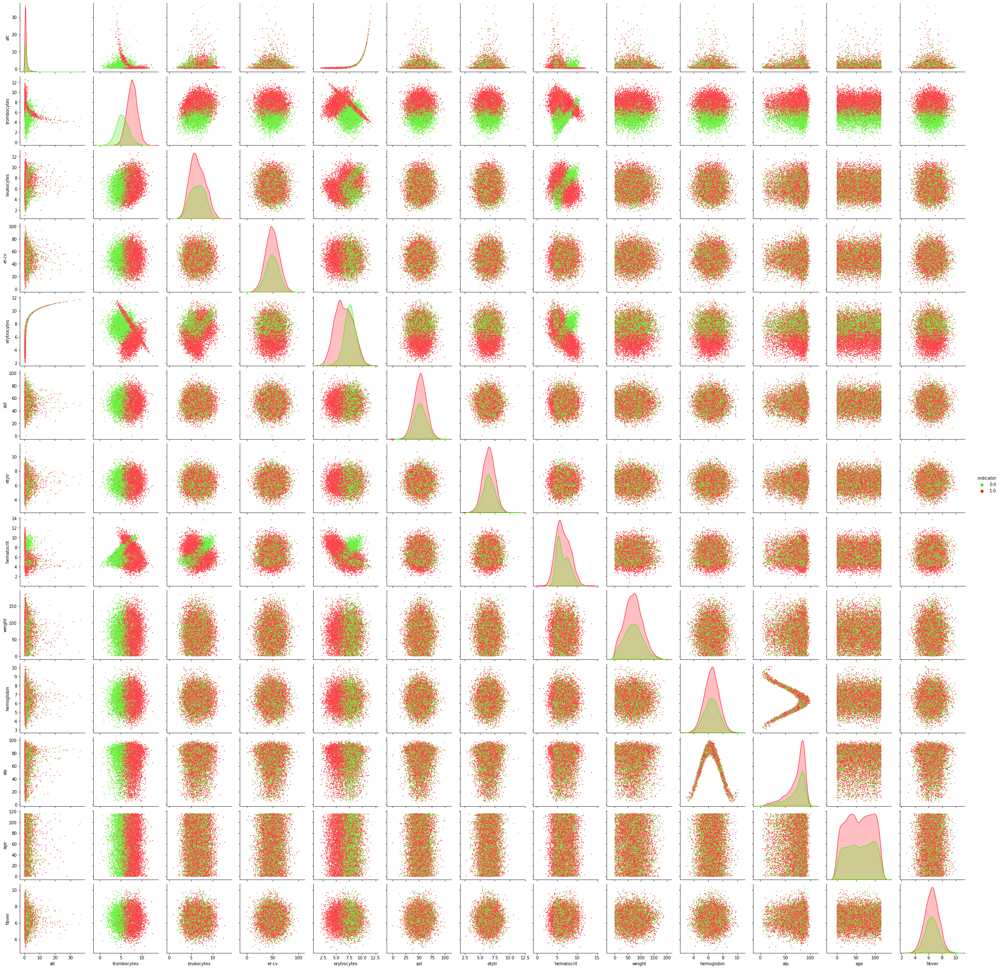

In [54]:
sns.set_palette('prism')
sns.pairplot(data, hue="indicator", plot_kws={"s": 4})

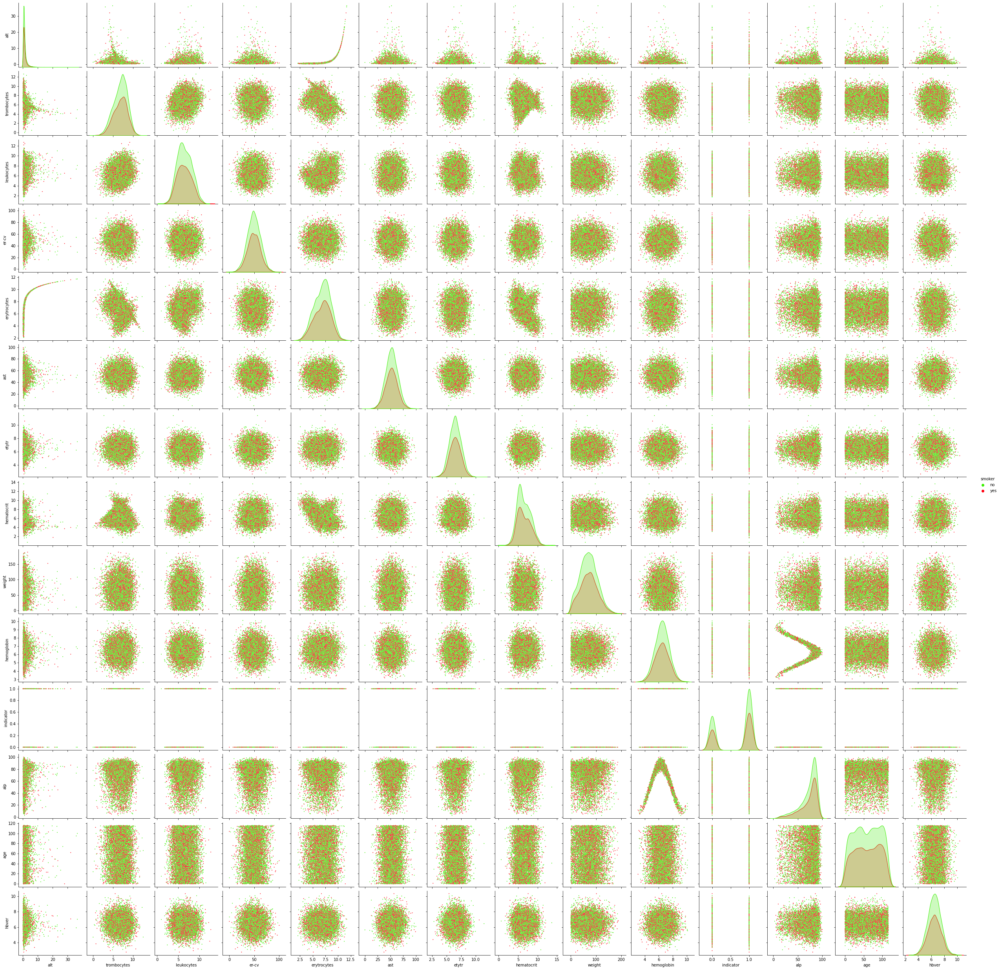

In [55]:
sns.pairplot(data, hue="smoker", plot_kws={"s": 4})

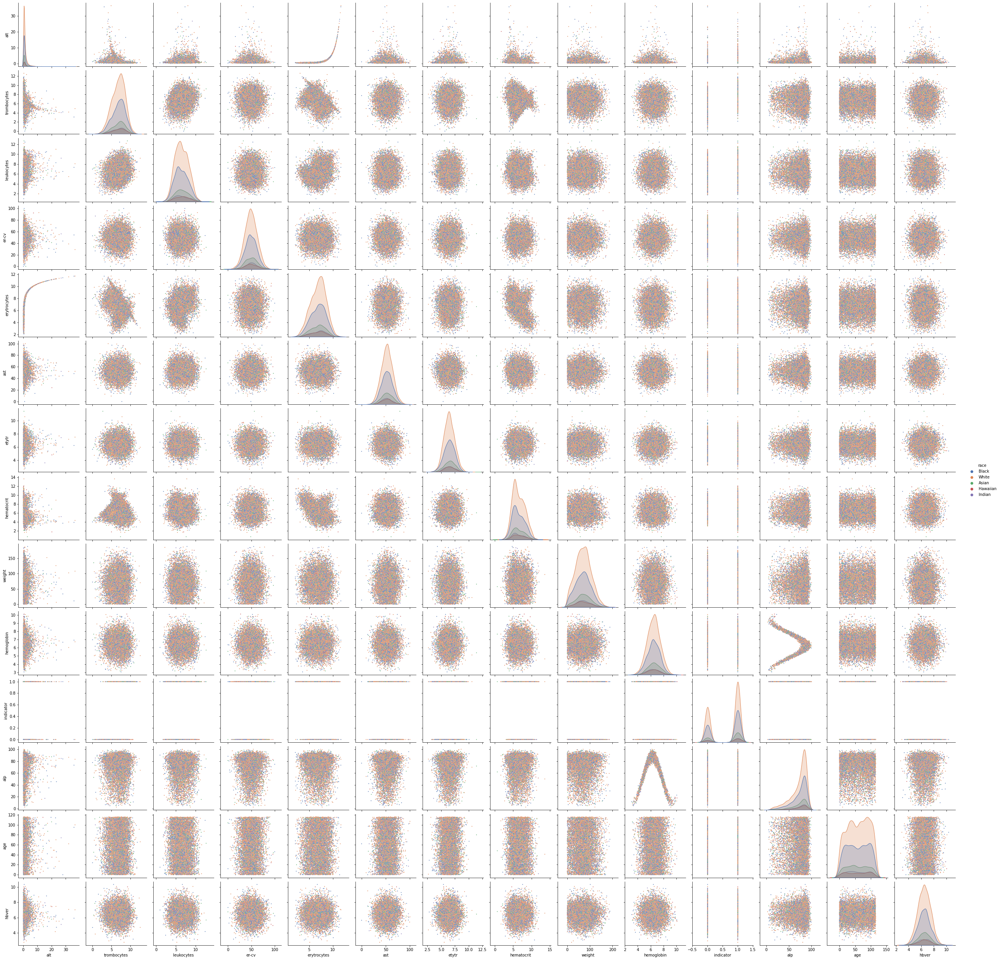

In [56]:
sns.set_palette('deep')
sns.pairplot(data, hue="race", plot_kws={"s": 4})

Pre atribútý race a smoker nezvnikajú žiadne zhluky hodnôt v párovom grafe spojitých údajov pre ich jednotlivé kategórie. Takto to bolo aj pre ostatné diskrétne atribúty okrem indikátora. Pri rozdeľovaní podľa indikátora vznikajú pre určité dvojice zaujímavé zhluky.

<AxesSubplot:xlabel='race', ylabel='trombocytes'>

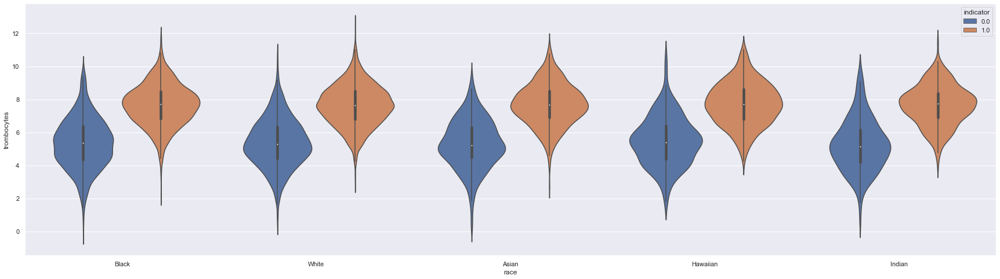

In [57]:
sns.set(rc={'figure.figsize':(30,8)})
sns.violinplot(data=data, x='race', y='trombocytes', hue="indicator")

<AxesSubplot:xlabel='sex', ylabel='weight'>

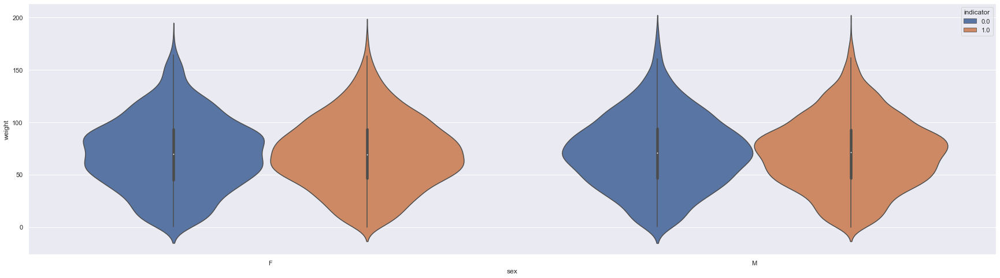

In [58]:
sns.set(rc={'figure.figsize':(30,8)})
sns.violinplot(data=data, x='sex', y='weight', hue="indicator")

Aj napriek tomu, že trombocyty s indikátorom kladne korelujú tak nie sú vidieť rozdiely naprieč inými diskrétnymi hodnotami.
Ani pri iných atribútoch nie sú badateľné výrazné anomálie.

In [59]:
sns.set(rc={'figure.figsize':(15,10)})

<AxesSubplot:xlabel='trombocytes', ylabel='erytrocytes'>

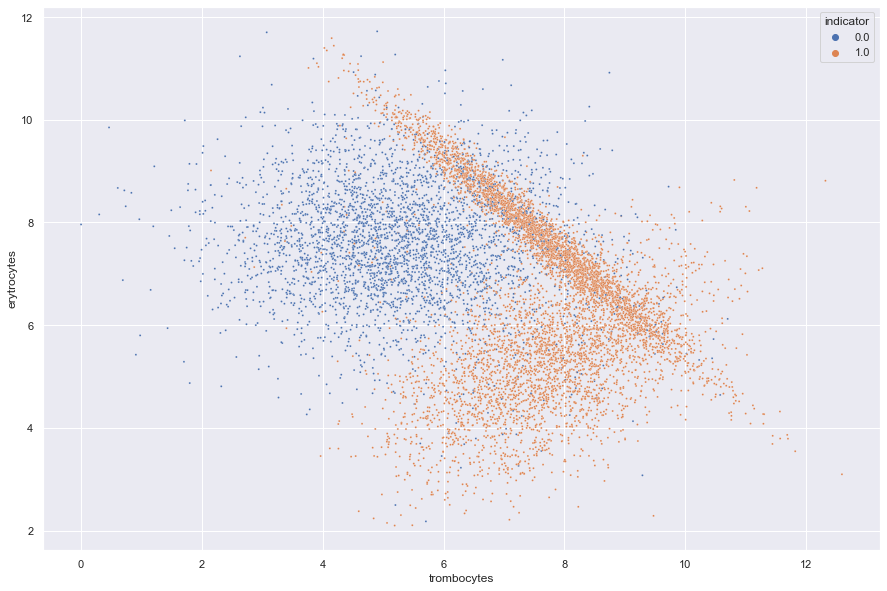

In [60]:
sns.scatterplot(data=data, x="trombocytes", y="erytrocytes", hue='indicator', s=4)

<AxesSubplot:xlabel='trombocytes', ylabel='erytrocytes'>

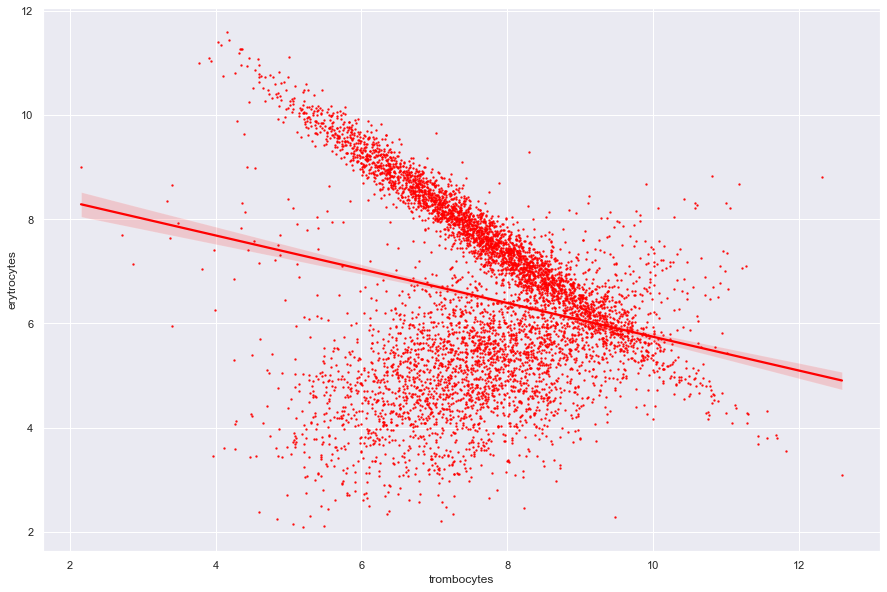

In [61]:
sns.regplot(data=data[data.indicator == 1], x="trombocytes", y="erytrocytes", color='red', scatter_kws={'s':2})

<AxesSubplot:xlabel='hematocrit', ylabel='erytrocytes'>

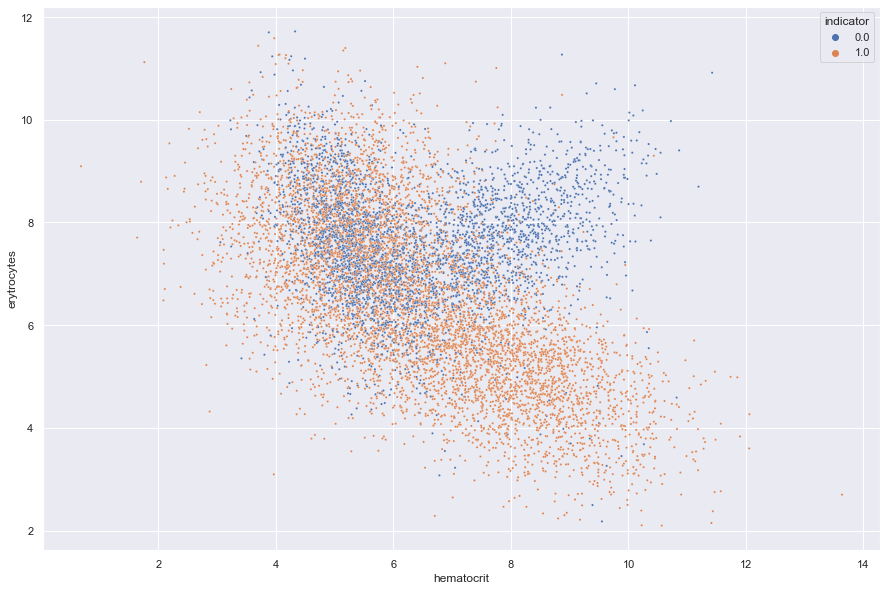

In [62]:
sns.scatterplot(data=data, x="hematocrit", y="erytrocytes", hue='indicator', s=5)

<AxesSubplot:xlabel='hematocrit', ylabel='erytrocytes'>

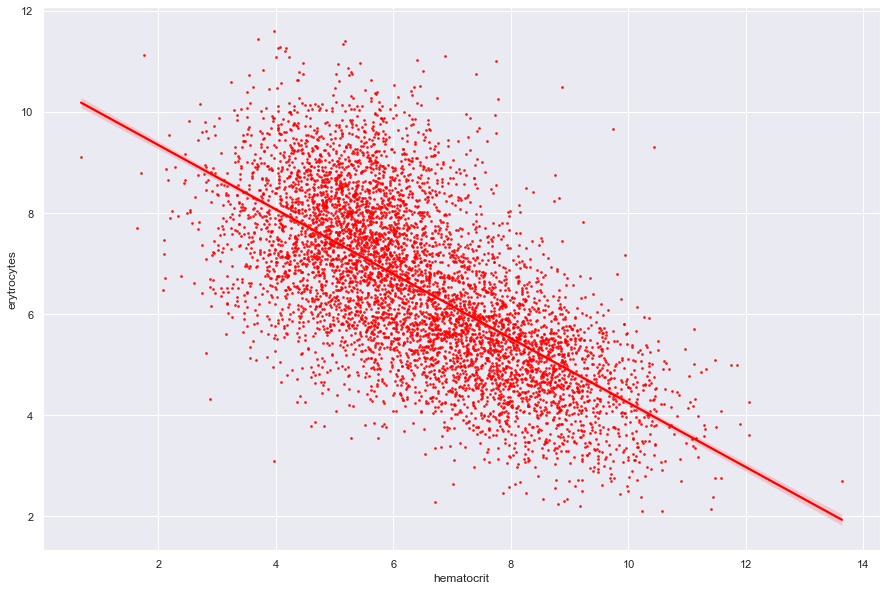

In [63]:
sns.regplot(data=data[data.indicator == 1], x="hematocrit", y="erytrocytes", scatter_kws={'s':3}, color='red')

<AxesSubplot:xlabel='erytrocytes', ylabel='leukocytes'>

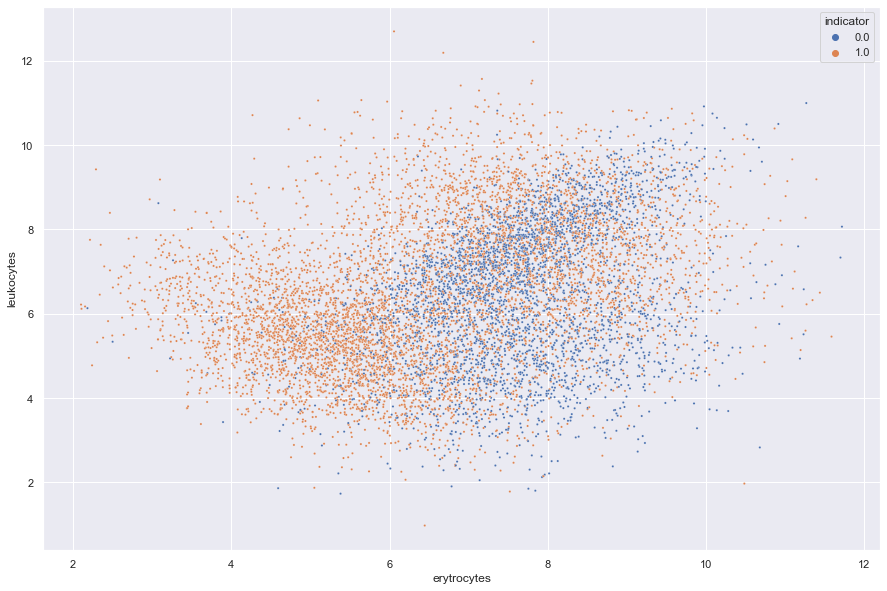

In [64]:
sns.scatterplot(data=data, x="erytrocytes", y="leukocytes", hue='indicator', s=5)

<AxesSubplot:xlabel='erytrocytes', ylabel='leukocytes'>

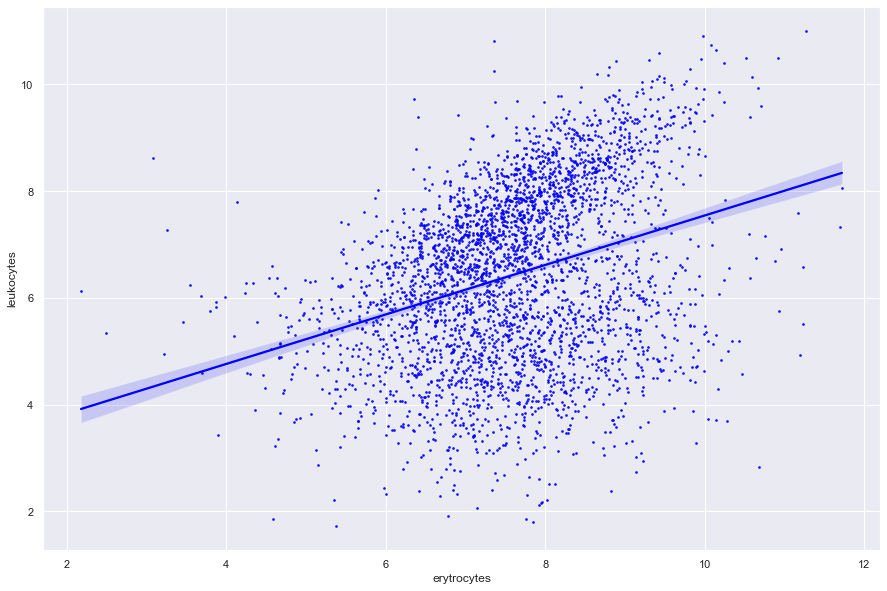

In [65]:
sns.regplot(data=data[data.indicator == 0], x="erytrocytes", y="leukocytes", scatter_kws={'s':3}, color='blue')

<AxesSubplot:xlabel='erytrocytes', ylabel='leukocytes'>

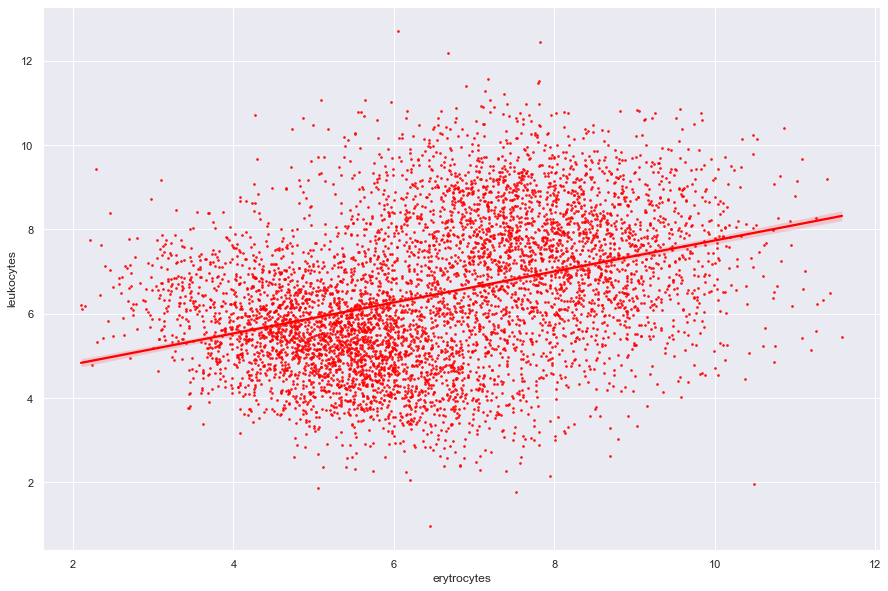

In [66]:
sns.regplot(data=data[data.indicator == 1], x="erytrocytes", y="leukocytes", scatter_kws={'s':3}, color='red')

<AxesSubplot:xlabel='trombocytes', ylabel='alt'>

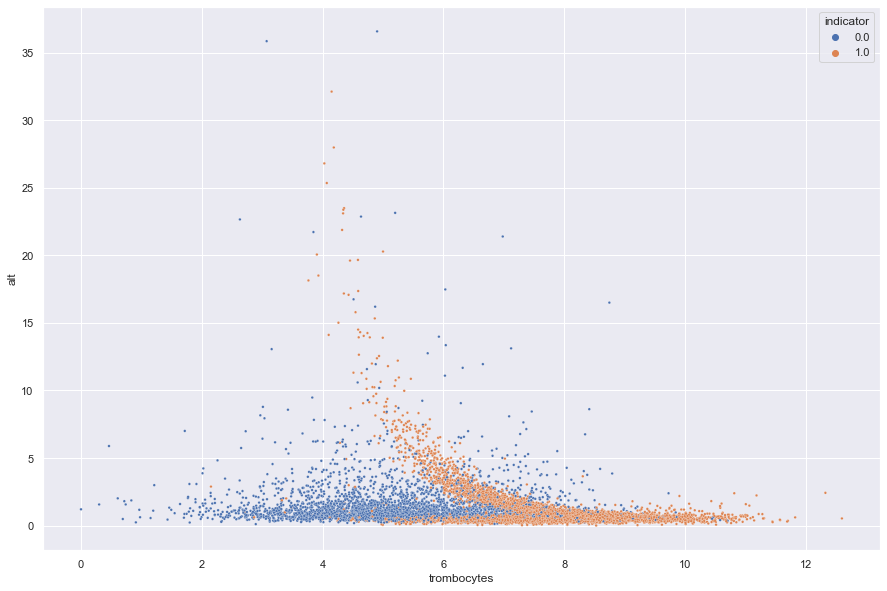

In [67]:
sns.scatterplot(data=data, x="trombocytes", y="alt", hue='indicator', s=7)

<AxesSubplot:xlabel='hemoglobin', ylabel='alp'>

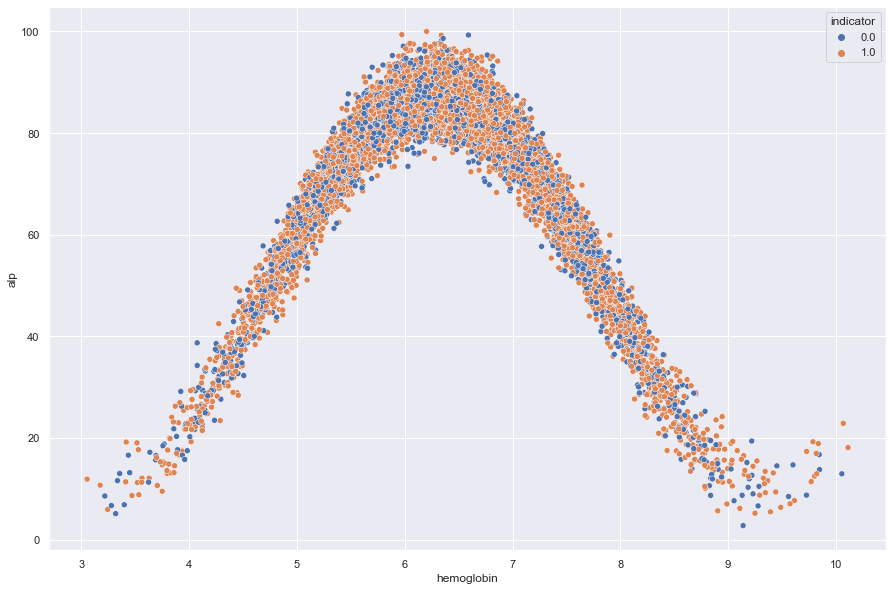

In [68]:
sns.scatterplot(data=data, x="hemoglobin", y="alp", hue="indicator")

<AxesSubplot:xlabel='indicator', ylabel='er-cv'>

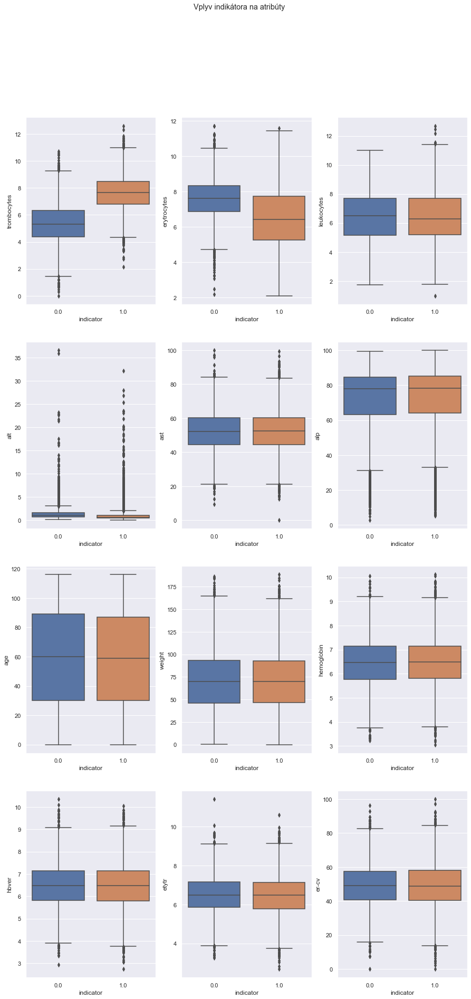

In [69]:
fig, axes = plt.subplots(4, 3, figsize=(15, 30))

fig.suptitle('Vplyv indikátora na atribúty')

sns.boxplot(ax=axes[0, 0], data=data, x="indicator", y="trombocytes")
sns.boxplot(ax=axes[0, 1], data=data, x="indicator", y="erytrocytes")
sns.boxplot(ax=axes[0, 2], data=data, x="indicator", y="leukocytes")
sns.boxplot(ax=axes[1, 0], data=data, x="indicator", y="alt")
sns.boxplot(ax=axes[1, 1], data=data, x="indicator", y="ast")
sns.boxplot(ax=axes[1, 2], data=data, x="indicator", y="alp")
sns.boxplot(ax=axes[2, 0], data=data, x="indicator", y="age")
sns.boxplot(ax=axes[2, 1], data=data, x="indicator", y="weight")
sns.boxplot(ax=axes[2, 2], data=data, x="indicator", y="hemoglobin")
sns.boxplot(ax=axes[3, 0], data=data, x="indicator", y="hbver")
sns.boxplot(ax=axes[3, 1], data=data, x="indicator", y="etytr")
sns.boxplot(ax=axes[3, 2], data=data, x="indicator", y="er-cv")

<AxesSubplot:xlabel='smoker', ylabel='er-cv'>

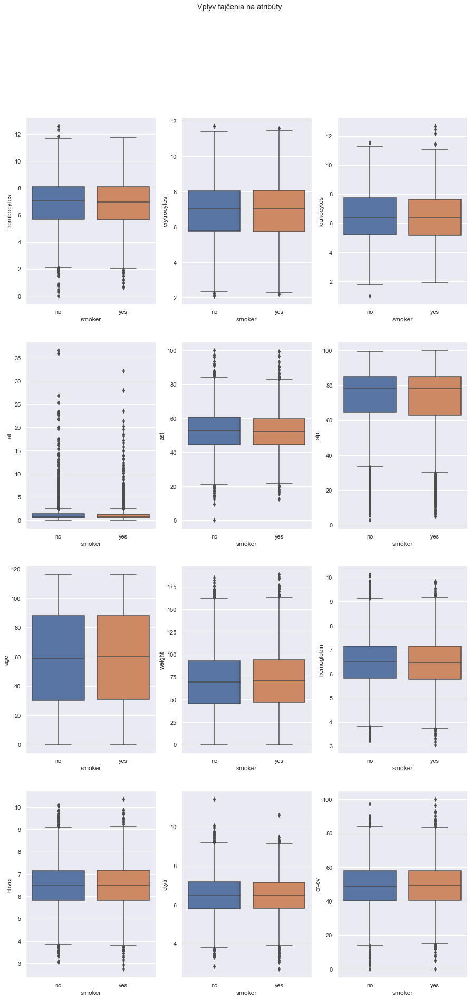

In [70]:
fig, axes = plt.subplots(4, 3, figsize=(15, 30))

fig.suptitle('Vplyv fajčenia na atribúty')

sns.boxplot(ax=axes[0, 0], data=data, x="smoker", y="trombocytes")
sns.boxplot(ax=axes[0, 1], data=data, x="smoker", y="erytrocytes")
sns.boxplot(ax=axes[0, 2], data=data, x="smoker", y="leukocytes")
sns.boxplot(ax=axes[1, 0], data=data, x="smoker", y="alt")
sns.boxplot(ax=axes[1, 1], data=data, x="smoker", y="ast")
sns.boxplot(ax=axes[1, 2], data=data, x="smoker", y="alp")
sns.boxplot(ax=axes[2, 0], data=data, x="smoker", y="age")
sns.boxplot(ax=axes[2, 1], data=data, x="smoker", y="weight")
sns.boxplot(ax=axes[2, 2], data=data, x="smoker", y="hemoglobin")
sns.boxplot(ax=axes[3, 0], data=data, x="smoker", y="hbver")
sns.boxplot(ax=axes[3, 1], data=data, x="smoker", y="etytr")
sns.boxplot(ax=axes[3, 2], data=data, x="smoker", y="er-cv")

_____

## Formulácia a štatistické overenie hypotéz o dátach

### Prvá hypotéza

$H_0$ - Priemerné trombocyty u pacientov, ktorých stav sa zhoršil sú rovnaké ako u tých,ktorých stav je stabilizovaný.

- Alternatívna hypotéza $H_1$ (ak by neplatila nulová $H_0$)

$H_1$ - Priemerné trombocyty u pacientov, ktorých stav sa zhoršil sú vyššie ako u tých,ktorých stav je stabilizovaný.

trombocytes_no_indicator mean= 5.352428030876784
trombocytes_indicator mean= 7.652289692705807


D:\zDokumenty\IAU\iauProstredie\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\zDokumenty\IAU\iauProstredie\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


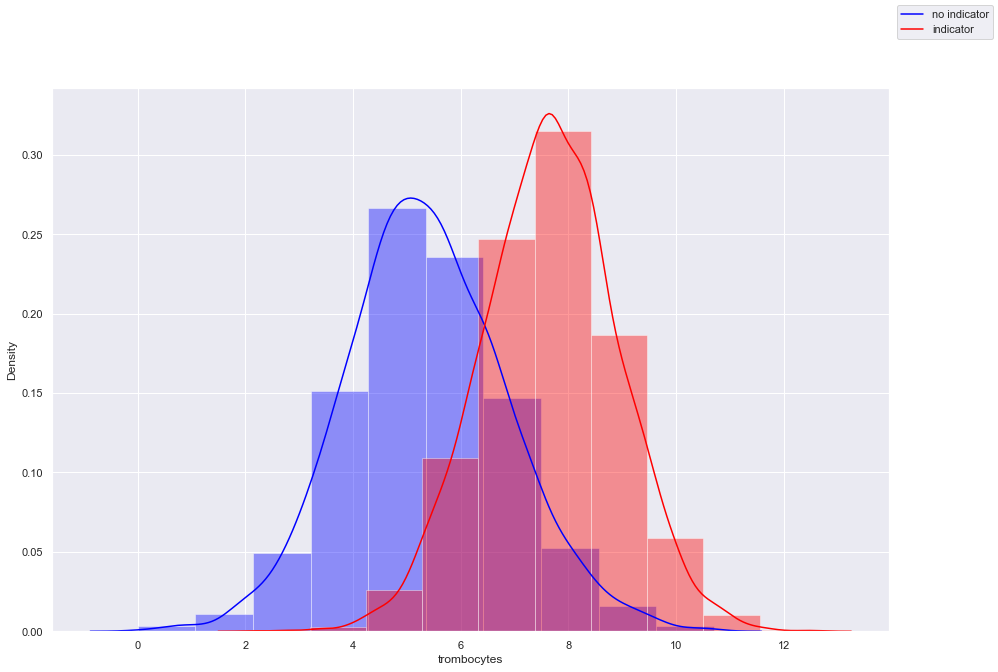

<AxesSubplot:xlabel='trombocytes', ylabel='Count'>

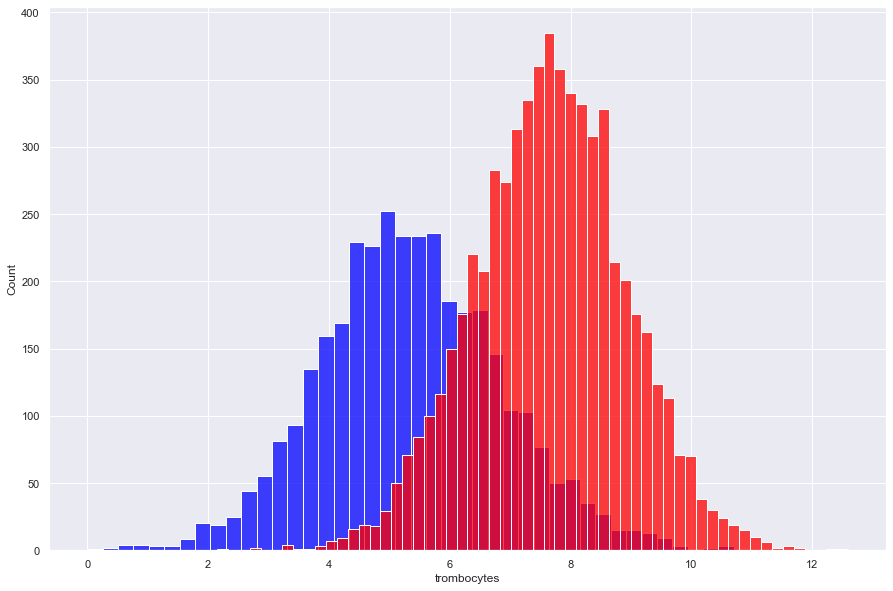

In [71]:
fig = plt.figure(figsize=(15,10))
sns.set(rc={'figure.figsize':(15,10)})

trombocytes_no_indicator = data.loc[data.indicator == 0, 'trombocytes']
trombocytes_indicator = data.loc[data.indicator == 1, 'trombocytes']

print('trombocytes_no_indicator mean=', trombocytes_no_indicator.mean())
print('trombocytes_indicator mean=', trombocytes_indicator.mean())

sns.distplot(trombocytes_no_indicator, bins=10, color='blue')
sns.distplot(trombocytes_indicator, bins=10, color='red')
fig.legend(labels=['no indicator','indicator'])
plt.show()

sns.histplot(trombocytes_no_indicator, color='blue')
sns.histplot(trombocytes_indicator, color='red')

Z grafov je vidieť, že priemerná hodnota trombocytov u pacientov s indikátorom 1 je vyššia ako u pacientov bez indikátora.

In [72]:
from numpy import var
#from numpy import random
print("len1 " + str(len(list(trombocytes_indicator))))
print("len2 " + str(len(list(trombocytes_no_indicator))))

print("var1 " + str(var(trombocytes_indicator)))
print("var2 " + str(var(trombocytes_no_indicator)))

# sample1 = pd.Series(np.random.choice(trombocytes_indicator, 500))
# sample2 = pd.Series(np.random.choice(trombocytes_no_indicator, 500))

# from scipy.stats import pearsonr
# from numpy import cov

# corr, _ = pearsonr(sample1, sample2) 
# print('Pearsons correlation: %.3f' % corr)

# covariance = cov(sample1, sample2)[0, 1]
# print("cov " + str(covariance))

len1 6183
len2 3433
var1 1.568874614447617
var2 2.229687885638593


In [73]:
trombocytes_indicator.describe()

count    6183.000000
mean        7.652290
std         1.252649
min         2.151230
25%         6.815510
50%         7.665770
75%         8.485860
max        12.595220
Name: trombocytes, dtype: float64

In [74]:
trombocytes_no_indicator.describe()

count    3433.000000
mean        5.352428
std         1.493431
min         0.000000
25%         4.370430
50%         5.301020
75%         6.327590
max        10.703870
Name: trombocytes, dtype: float64

Vidíme, že obidve vzorky dát sú pomerne početné. Zároveň nemajú rovnakú varianciu. V zakomentovanom kóde je náhodné subsetnutie vzoriek na rovnakú veľkosť, ktorá je potrebná pre vypočítanie korelácie a kovariancie. Ak by sme to spravili tak zistíme, že aj korelácia aj kovariancia sú veľmi nízke.

In [75]:
sns.set(rc={'figure.figsize':(10,8)})
from scipy.stats import shapiro

#sns.histplot(trombocytes_indicator, bins=20)
shapiro_test = shapiro(trombocytes_indicator)
print(shapiro_test)


# interpret
alpha = 0.05
if shapiro_test.pvalue > alpha:
    print('Normal distribution (fail to reject H0)')
else:
    print('Another distributions (reject H0)')

ShapiroResult(statistic=0.9995512366294861, pvalue=0.15534424781799316)
Normal distribution (fail to reject H0)


D:\zDokumenty\IAU\iauProstredie\lib\site-packages\scipy\stats\morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


In [76]:
#sns.histplot(trombocytes_no_indicator, bins=20)
shapiro_test = shapiro(trombocytes_no_indicator)
print(shapiro_test)

# interpret
alpha = 0.05
if shapiro_test.pvalue > alpha:
    print('Normal distribution (fail to reject H0)')
else:
    print('Another distributions (reject H0)')

ShapiroResult(statistic=0.9980671405792236, pvalue=0.00031427829526364803)
Another distributions (reject H0)


Shapiro-Wilkov test normality ukázal nasledovné:
- Skupina s indikátorom má normálne rozdelenie
- Skupina bez indikátora nemá normálne rozdelenie

Keďže vzorky sú pomerne veľké môžme skúsiť vykonať Anderson-Darlingov test pre normálnu distribúciu.

In [77]:
from scipy.stats import anderson

anderson_test = anderson(trombocytes_indicator, dist="norm")
print('Statistic (pvalue): %.3f' % anderson_test.statistic)
p = 0
for i in range(len(anderson_test.critical_values)):
    sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
    if anderson_test.statistic < anderson_test.critical_values[i]:
        print('%.3f: %.3f, Normal distribution (fail to reject H0)' % (sl, cv))
    else:
        print('%.3f: %.3f, Another distributions (reject H0)' % (sl, cv))

Statistic (pvalue): 0.653
15.000: 0.576, Another distributions (reject H0)
10.000: 0.656, Normal distribution (fail to reject H0)
5.000: 0.786, Normal distribution (fail to reject H0)
2.500: 0.917, Normal distribution (fail to reject H0)
1.000: 1.091, Normal distribution (fail to reject H0)


In [78]:
anderson_test = anderson(trombocytes_no_indicator, dist="norm")
print('Statistic (pvalue): %.3f' % anderson_test.statistic)
p = 0
for i in range(len(anderson_test.critical_values)):
    sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
    if anderson_test.statistic < anderson_test.critical_values[i]:
        print('%.3f: %.3f, Normal distribution (fail to reject H0)' % (sl, cv))
    else:
        print('%.3f: %.3f, Another distributions (reject H0)' % (sl, cv))

Statistic (pvalue): 1.894
15.000: 0.575, Another distributions (reject H0)
10.000: 0.655, Another distributions (reject H0)
5.000: 0.786, Another distributions (reject H0)
2.500: 0.917, Another distributions (reject H0)
1.000: 1.091, Another distributions (reject H0)


Dané testy nám potvrdili predpokladané distribúcie obidvoch vzoriek.

Pri vzorke s indikátorom zamietnutie $H_0$ pri $\alpha$ = 0.15 nič neznamená. Ide o soft fail, dôležitá je pre nás hodnota pre $\alpha$ = 0.05

Naše tvrdenia si môžme ešte potvrdiť pomocou QQ plot.

D:\zDokumenty\IAU\iauProstredie\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)
D:\zDokumenty\IAU\iauProstredie\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


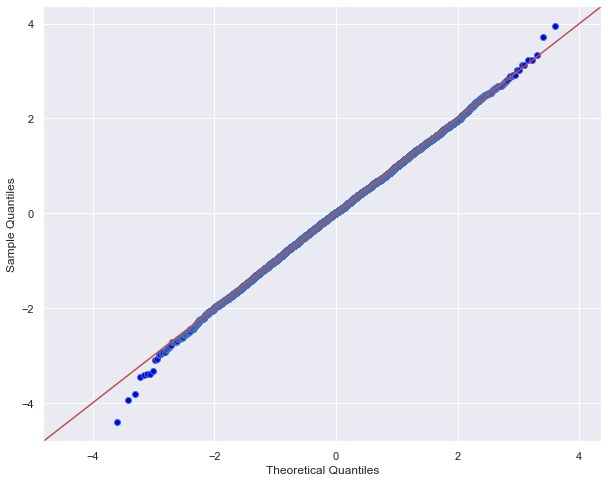

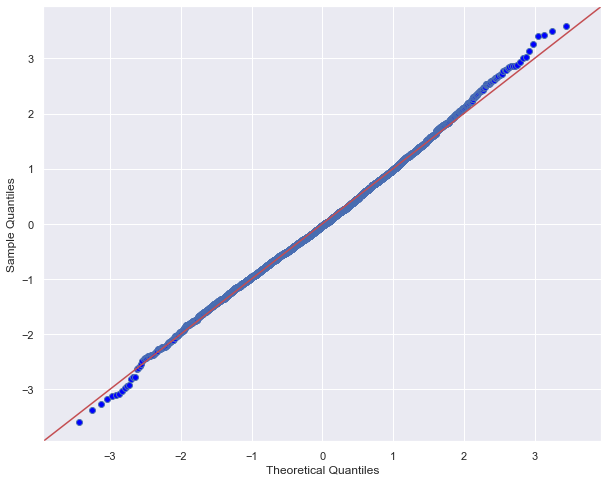

In [79]:
sm.qqplot(trombocytes_indicator, fit=True, line='45')
sm.qqplot(trombocytes_no_indicator, fit=True, line='45')
py.show()

Pri vzorke s indikátorom (prvý graf) body opisujú normálne rozdelenie. Pri vzorke bez indikátoru (druhý graf) môžeme vidieť jemný heavy tail a right-skew. Môžeme teda potvrdiť nasledovné:
- Skupina s indikátorom má normálne rozdelenie
- Skupina bez indikátora nemá normálne rozdelenie

Keďže obe distribúcie nie sú z Gaussovho rozdelenia musíme použiť neparametrické testy. 

Naše dáta sú nepárové, pretože máme dve rozličné skupiny rozdelené indikátorom.

In [80]:
from scipy.stats import levene

levene_test = levene(trombocytes_indicator, trombocytes_no_indicator)
print(levene_test)

# interpret
alpha = 0.05
if levene_test.pvalue > alpha:
    print('Equal variances (fail to reject H0)')
else:
    print('Another variances (reject H0)')

LeveneResult(statistic=112.9383851260084, pvalue=3.111363046431166e-26)
Another variances (reject H0)


Zároveň naše dáta majú rozdielne variancie a tiež majú veľké vzorky. Môžeme použiť Mann-Whitney U test ako náhradu za T-test.

In [81]:
from scipy.stats import mannwhitneyu

stat, p = mannwhitneyu(trombocytes_indicator, trombocytes_no_indicator) 
print('Statistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distribution (fail to reject H0)') 
else:
    print('Different distribution (reject H0)')

Statistics=18700566.000, p=0.000000000000000
Different distribution (reject H0)


Vidíme, že dátove vzorky sú z populácie, ktorá nemá rovnakú distribúciu. P-hodnota vyšla rovná 0. Teda môžeme predpokladať že majú rôzne mediány. 

Pre overenie môžeme použiť Kolmogorov-Smirnov test.

In [82]:
from scipy.stats import kstest
from scipy.stats import ks_2samp

stat, p = kstest(trombocytes_indicator, trombocytes_no_indicator)
print('Statistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

stat, p = ks_2samp(trombocytes_indicator, trombocytes_no_indicator)
print('\nStatistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

Statistics=0.608, p=0.999999999629981
Same distributions (fail to reject H0)

Statistics=0.608, p=0.999999999629981
Same distributions (fail to reject H0)


Ten nám však ukázal, že aj napriek tomu, že testy pre jednotlivé vzorky ukazujú rôzne rozdelenia v porovnaní s Gaussovým rozdelením tak pri porovnaní vzoriek samotných ukazujú rovnaké rozdelenie. Môže to byť spôsobené viacerými príčinami. Ak by sme odstránili heavy tail pre bezindikátorových, distribúcia sa podobá na normálnu. Tiež Mann-Whitneyho test počíta s rozdielom mediánov, ktorý je pri takomto teste signifikantný. 

Za predpokladu, že obdive vzorky sú z normálnej distribúcie skúsme vykonať nasledovné testy.

In [83]:
from scipy.stats import ttest_ind
import statsmodels.stats.api as sms

stat, p = ttest_ind(trombocytes_indicator, trombocytes_no_indicator)
print('Statistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

stat, p = sms.ztest(trombocytes_indicator, trombocytes_no_indicator)
print('\nStatistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

Statistics=80.423, p=0.000000000000000
Different distributions (reject H0)

Statistics=80.423, p=0.000000000000000
Different distributions (reject H0)


Vhodný by bol t-test ale keďže variancie vzoriek nie sú homogénne viacej sa hodí z-test. Obidva testy nám však popreli nulovú hypotézy a teda môžme predpokladať, že vzorky sú z rôznej populácie.

Skúsme vypočítať Cohenovo **d**.

In [84]:
from numpy import var
from math import sqrt
from numpy import mean

def cohend(d1, d2):
    # calculate the size of samples
    n1, n2 = len(d1), len(d2) 
    
    # calculate the variance of the samples
    s1, s2 = var(d1, ddof=1), var(d2, ddof=1)

    # calculate the pooled standard deviation
    s = sqrt(((n1 - 1) * s1 + (n2 - 1) * s2) / (n1 + n2 - 2)) 
    
    # calculate the means of the samples
    u1, u2 = mean(d1), mean(d2)
    
    # calculate the effect size
    d = (u1 - u2) / s 
    return d

cd = cohend(trombocytes_indicator, trombocytes_no_indicator)
print('Cohens d value: %f' % cd)

# interpret
if 0.2 <= cd < 0.5:
    print('Small effect - Cohens d value: %f' % cd)
elif 0.5 <= cd < 0.8:
    print('Medium effect - Cohens d value: %f' % cd)
elif 0.8 <= cd:
    print('Large effect - Cohens d value: %f' % cd)

Cohens d value: 1.711761
Large effect - Cohens d value: 1.711761


Štatistická sila pre vykonané testy je dostatočne silná a teda chyby by nemali nastať.

In [85]:
import statsmodels.stats.api as sms

sms.DescrStatsW(trombocytes_indicator).tconfint_mean()

(7.621060356981095, 7.683519028430515)

In [86]:
sms.DescrStatsW(trombocytes_no_indicator).tconfint_mean()

(5.3024533905147555, 5.402402671238812)

Interval spoľahlivosti nám ukazuje, že s 95% pravdepodobnosťou sa skutočná hodnota priemeru bude nachádzať v danom intervale. Vidíme, že intervaly pre vzorku s indikátorom sú vyššie.

Hodnota *d* nám zároveň udáva rozdiel priemerov z dvoch vzoriek. Vidíme, že je dostatočne veľká. 

S prihliadnutím na všetky vykonané testy môžme zamietnuť nulovú hypotézu $H_0$.
A to v prospech alternatívnej hypotézy $H_1$ - Priemerné trombocyty u pacientov, ktorých stav sa zhoršil sú vyššie ako u tých,ktorých stav je stabilizovaný.

**--------------------------------------------------------------------------------------------------------------------------------------------**
### Druhá hypotéza

$H_0$ - Priemerné erytrocyty u pacientov, ktorých stav sa zhoršil sú rovnaké ako u tých,ktorých stav je stabilizovaný.

- Alternatívna hypotéza $H_1$ (ak by neplatila nulová $H_0$)

$H_1$ - Priemerné erytrocyty u pacientov, ktorých stav sa zhoršil sú nižšie ako u tých,ktorých stav je stabilizovaný.

In [87]:
print("Priemerné hodnoty erytrocytov")
print(str(data.loc[data.indicator == 1, 'erytrocytes'].mean()) + " stav sa zhoršil")
print(str(data.loc[data.indicator == 0, 'erytrocytes'].mean()) + " stav je stabilizovaný")

Priemerné hodnoty erytrocytov
6.504614315057416 stav sa zhoršil
7.598064171278764 stav je stabilizovaný


erytrocytes_indicator mean= 6.504614315057416
erytrocytes_no_indicator mean= 7.598064171278764


D:\zDokumenty\IAU\iauProstredie\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\zDokumenty\IAU\iauProstredie\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


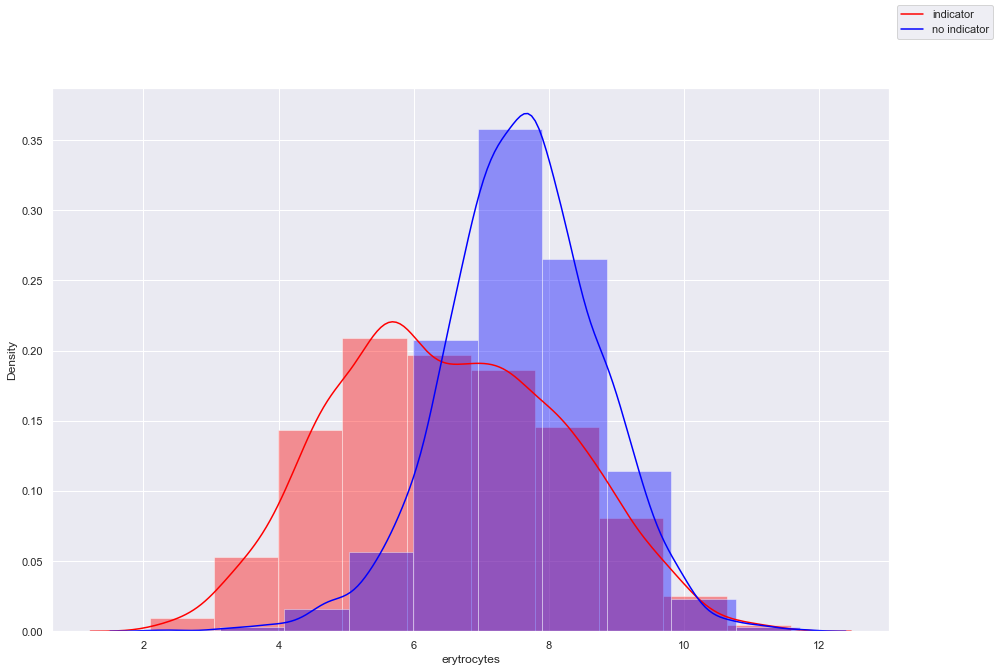

<AxesSubplot:xlabel='erytrocytes', ylabel='Count'>

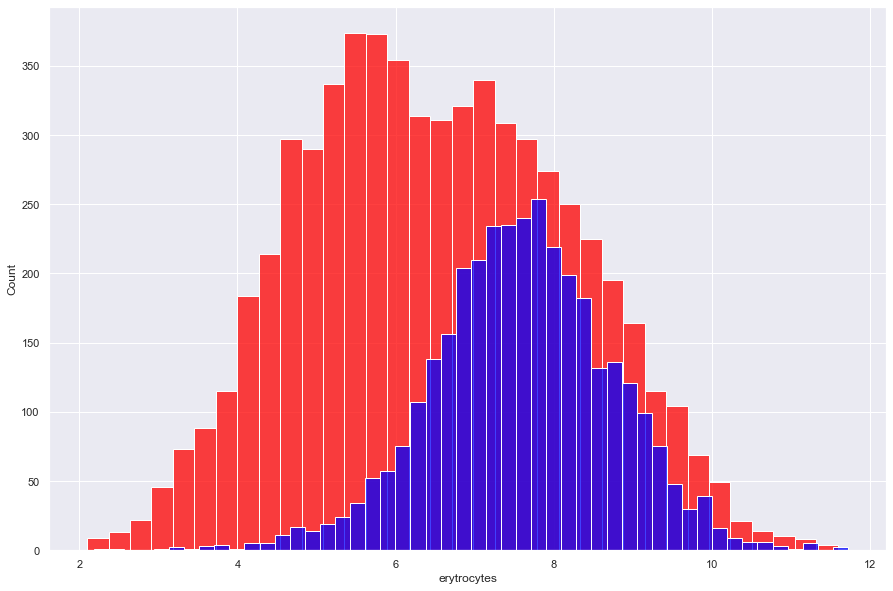

In [88]:
fig = plt.figure(figsize=(15,10))
sns.set(rc={'figure.figsize':(15,10)})

erytrocytes_indicator = data.loc[data.indicator == 1, 'erytrocytes']
erytrocytes_no_indicator = data.loc[data.indicator == 0, 'erytrocytes']

print('erytrocytes_indicator mean=', erytrocytes_indicator.mean())
print('erytrocytes_no_indicator mean=', erytrocytes_no_indicator.mean())

sns.distplot(erytrocytes_indicator, bins=10, color='red')
sns.distplot(erytrocytes_no_indicator, bins=10, color='blue')

fig.legend(labels=['indicator','no indicator'])
plt.show()

sns.histplot(erytrocytes_indicator, color='red')
sns.histplot(erytrocytes_no_indicator, color='blue')

Môžme vidieť a dá sa predpokladať, že hodnoty erytrocytov pre vzorky rozdelené podľa indikátora nie sú rovnaké.

In [89]:
erytrocytes_indicator.describe()

count    6183.000000
mean        6.504614
std         1.687882
min         2.099090
25%         5.254150
50%         6.430480
75%         7.748920
max        11.587890
Name: erytrocytes, dtype: float64

In [90]:
erytrocytes_no_indicator.describe()

count    3433.000000
mean        7.598064
std         1.141159
min         2.180020
25%         6.886350
50%         7.618890
75%         8.332540
max        11.719730
Name: erytrocytes, dtype: float64

In [91]:
print("var1 " + str(var(trombocytes_indicator)))
print("var2 " + str(var(trombocytes_no_indicator)))

var1 1.568874614447617
var2 2.229687885638593


Vzorky majú rovnaký počet hodnôt ako pri predošlej hypotéze keďže sú rozdelené znovu podľa indikátora. Vzorky nemajú rovnakú varianciu.

In [92]:
from scipy.stats import shapiro

shapiro_test = shapiro(erytrocytes_indicator)
print(shapiro_test)


# interpret
alpha = 0.05
if shapiro_test.pvalue > alpha:
    print('Normal distribution (fail to reject H0)')
else:
    print('Another distributions (reject H0)')

ShapiroResult(statistic=0.9928735494613647, pvalue=4.54821355519791e-17)
Another distributions (reject H0)


D:\zDokumenty\IAU\iauProstredie\lib\site-packages\scipy\stats\morestats.py:1760: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


In [93]:
from scipy.stats import shapiro

shapiro_test = shapiro(erytrocytes_no_indicator)
print(shapiro_test)


# interpret
alpha = 0.05
if shapiro_test.pvalue > alpha:
    print('Normal distribution (fail to reject H0)')
else:
    print('Another distributions (reject H0)')

ShapiroResult(statistic=0.9952865242958069, pvalue=5.026247862360833e-09)
Another distributions (reject H0)


Shapiro-Wilkov test ukázal, že obidve vzorky nepochádzajú z normálneho rozdelenia. Môžme to skúsiť potvrdiť Anderson-Darlingovým testom.

In [94]:
from scipy.stats import anderson

anderson_test = anderson(erytrocytes_indicator, dist="norm")
print('Statistic (pvalue): %.3f' % anderson_test.statistic)
p = 0
for i in range(len(anderson_test.critical_values)):
    sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
    if anderson_test.statistic < anderson_test.critical_values[i]:
        print('%.3f: %.3f, Normal distribution (fail to reject H0)' % (sl, cv))
    else:
        print('%.3f: %.3f, Another distributions (reject H0)' % (sl, cv))

Statistic (pvalue): 13.110
15.000: 0.576, Another distributions (reject H0)
10.000: 0.656, Another distributions (reject H0)
5.000: 0.786, Another distributions (reject H0)
2.500: 0.917, Another distributions (reject H0)
1.000: 1.091, Another distributions (reject H0)


In [95]:
anderson_test = anderson(erytrocytes_no_indicator, dist="norm")
print('Statistic (pvalue): %.3f' % anderson_test.statistic)
p = 0
for i in range(len(anderson_test.critical_values)):
    sl, cv = anderson_test.significance_level[i], anderson_test.critical_values[i]
    if anderson_test.statistic < anderson_test.critical_values[i]:
        print('%.3f: %.3f, Normal distribution (fail to reject H0)' % (sl, cv))
    else:
        print('%.3f: %.3f, Another distributions (reject H0)' % (sl, cv))

Statistic (pvalue): 2.294
15.000: 0.575, Another distributions (reject H0)
10.000: 0.655, Another distributions (reject H0)
5.000: 0.786, Another distributions (reject H0)
2.500: 0.917, Another distributions (reject H0)
1.000: 1.091, Another distributions (reject H0)


Dané testy nám potvrdili predpokladané distribúcie obidvoch vzoriek.

Naše tvrdenia si môžme ešte potvrdiť pomocou QQ-grafu.

D:\zDokumenty\IAU\iauProstredie\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)
D:\zDokumenty\IAU\iauProstredie\lib\site-packages\statsmodels\graphics\gofplots.py:993: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "bo" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(x, y, fmt, **plot_style)


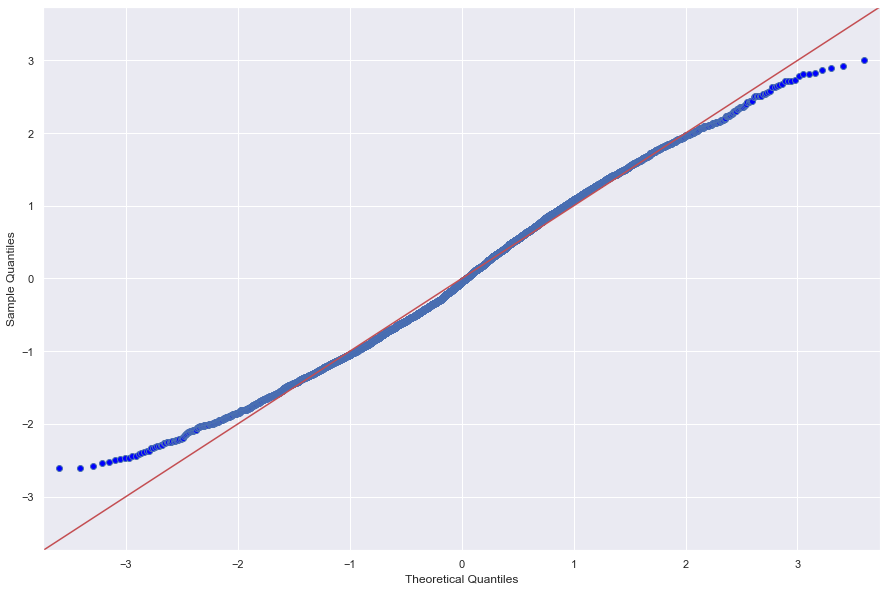

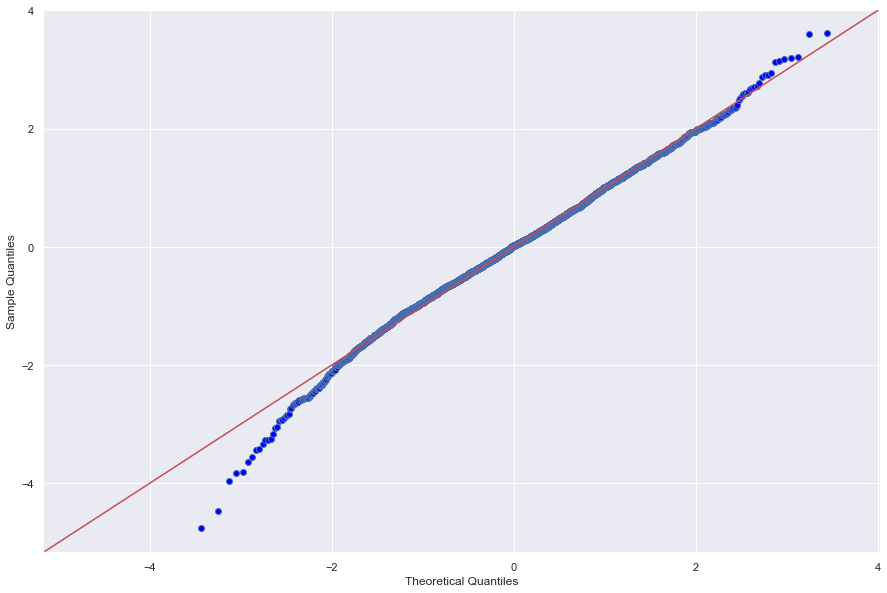

In [96]:
sm.qqplot(erytrocytes_indicator, fit=True, line='45')
sm.qqplot(erytrocytes_no_indicator, fit=True, line='45')
py.show()

Pri vzorke s indikátorom (prvý graf) má vzorka heavy tail.
Pri vzorke bez indikátoru (druhý graf) je vidieť left-skew.

Keďže obe distribúcie nie sú z Gaussovho rozdelenia musíme použiť neparametrické testy. 

Naše dáta sú nepárové, pretože máme dve rozličné skupiny rozdelené indikátorom.

In [97]:
from scipy.stats import levene

levene_test = levene(erytrocytes_no_indicator, erytrocytes_indicator)
print(levene_test)

# interpret
alpha = 0.05
if levene_test.pvalue > alpha:
    print('Equal variances (fail to reject H0)')
else:
    print('Another variances (reject H0)')

LeveneResult(statistic=755.3109691769617, pvalue=3.881915085942558e-160)
Another variances (reject H0)


Zároveň naše dáta majú rozdielne variancie a tiež majú veľké vzorky. Môžeme použiť Mann-Whitney U test ako náhradu za T-test.

In [98]:
from scipy.stats import mannwhitneyu

stat, p = mannwhitneyu(erytrocytes_no_indicator, erytrocytes_indicator) 
print('Statistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distribution (fail to reject H0)') 
else:
    print('Different distribution (reject H0)')

Statistics=14871382.000, p=0.000000000000000
Different distribution (reject H0)


Vidíme, že dátove vzorky sú z populácie, ktorá nemá rovnakú distribúciu. P-hodnota vyšla rovná 0. Môžeme predpokladať že majú rôzne mediány. 

Pre toto overenie môžeme použiť Kolmogorov-Smirnov test.

In [99]:
from scipy.stats import kstest
from scipy.stats import ks_2samp

stat, p = kstest(erytrocytes_no_indicator, erytrocytes_indicator)
print('Statistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

stat, p = ks_2samp(erytrocytes_no_indicator, erytrocytes_indicator)
print('\nStatistics=%.3f, p=%.15f' % (stat, p))

# interpret
alpha = 0.05
if p > alpha:
    print('Same distributions (fail to reject H0)')
else:
    print('Different distributions (reject H0)')

Statistics=0.369, p=0.000000786095934
Different distributions (reject H0)

Statistics=0.369, p=0.000000786095934
Different distributions (reject H0)


Ten potvrdil, že vzorky nie sú z rovnakého rozdelenia. Ukázal hodnotu aspoň o trochu väčšiu ako nula, môžeme teda zamietnuť $H_0$.

Skúsme vypočítať Cohenovo **d**

In [100]:
from numpy import var
from math import sqrt
from numpy import mean

def cohend(d1, d2):
    # calculate the size of samples
    n1, n2 = len(d1), len(d2) 
    
    # calculate the variance of the samples
    s1, s2 = var(d1, ddof=1), var(d2, ddof=1)

    # calculate the pooled standard deviation
    s = sqrt(((n1 - 1) * s1 + (n2 - 1) * s2) / (n1 + n2 - 2)) 
    
    # calculate the means of the samples
    u1, u2 = mean(d1), mean(d2)
    
    # calculate the effect size
    d = (u1 - u2) / s 
    return d

cd = cohend(erytrocytes_no_indicator, erytrocytes_indicator)
print('Cohens d value: %f' % cd)

# interpret
if 0.2 <= cd < 0.5:
    print('Small effect - Cohens d value: %f' % cd)
elif 0.5 <= cd < 0.8:
    print('Medium effect - Cohens d value: %f' % cd)
elif 0.8 <= cd:
    print('Large effect - Cohens d value: %f' % cd)

Cohens d value: 0.721501
Medium effect - Cohens d value: 0.721501


Štatistická sila pre vykonané testy je takmer dostatočne silná. Blíži sa hodnote 0.8 a teda budeme predpokladať, že chyby by nemali nastať.

In [101]:
import statsmodels.stats.api as sms

sms.DescrStatsW(erytrocytes_indicator).tconfint_mean()

(6.46253431786093, 6.546694312253903)

In [102]:
sms.DescrStatsW(erytrocytes_no_indicator).tconfint_mean()

(7.55987762409839, 7.636250718459139)

Intervaly spoľahlivosti nám ukazujú, že priemery pre vzorky sa skutočne budú nachádzať z daných intervalov.

So všetkými vykonanými testami môžme zamietnuť $H_0$ v prospech alternatívnej hypotézy $H_1$ a síce priemerné erytrocyty u pacientov, ktorých stav sa zhoršil sú nižšie ako u tých,ktorých stav je stabilizovaný.